In [1]:
import os
import random
import numpy as np
from tqdm import tqdm
import shutil
from IPython.display import HTML

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from data_helper import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0);

device = ("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
data_dir = '/home/alexander/data'
annotation_csv = '/home/alexander/data/annotation.csv'

resume_training_from_checkpoint = True
load_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar'
save_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_epoch_100to200_checkpoint.pth.tar'

In [4]:
def save_checkpoint(fpath, state):
    torch.save(state, fpath)
    
def print_sys_mem_usage():
    print("Memory usage (RAM):\n")
    !free -h
    print("\nGPU Memory Usage:\n")
    !nvidia-smi --query-gpu=memory.used --format=csv
    !nvidia-smi --query-gpu=memory.total --format=csv
    print("\n")
    
def print_train_stats(epoch, n_epochs, i, n_batches, loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post):
    print('Epoch: [%d/%d]\tBatch: [%d/%d]\n' % (epoch + 1, n_epochs, i, n_batches),
          'Loss_D: %.4f\tLoss_G: %.4f\n' % (loss_d_total.item(), loss_g_total.item()),
          'D(real): %.4f  ||  D(gen) Pre-step: %.4f  ||  D(gen) Post-step: %.4f\n' %
          (d_real_mean, d_gen_mean_pre, d_gen_mean_post))

### Set Initial Parameters

In [5]:
batch_size = 32

### Create Dataset and Dataloader

In [6]:
unlabeled_scene_index = np.arange(106)
labeled_scene_index_train = np.arange(106, 130)
labeled_scene_index_test = np.arange(130, 134)

In [7]:
labeled_trainset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_train,
                                  img_transform=transforms.Compose([transforms.CenterCrop(256),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

trainloader = torch.utils.data.DataLoader(labeled_trainset,
                                          batch_size=batch_size,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [8]:
labeled_trainset[1][0].size()

torch.Size([18, 256, 256])

In [9]:
for images, road_maps in trainloader:
    print(images.size())
    break

torch.Size([32, 18, 256, 256])


### Define models

In [10]:
class ResnetBlock(nn.Module):
    """
    Define a Resnet block
    A resnet block is a conv block with skip connections
    Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
    """
    def __init__(self, dim):
        """
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        """
        super(ResnetBlock, self).__init__()
        self.resnet_block = nn.Sequential(nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim),
                                          nn.ReLU(True),
                                          nn.Dropout(0.5),
                                          nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim)
                                         )
        
    def forward(self, x):
        return x + self.resnet_block(x)  # add skip connections

In [11]:
class Generator(nn.Module):
    """
    RESNET-based generator that consists of Resnet blocks + downsampling/upsampling operations.
    """
    def __init__(self, in_ch, out_ch, ngf, n_blocks=6, init_gain=0.02):
        """
        Parameters:
            in_ch (int)         -- the number of channels in input images
            out_ch (int)        -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """        
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            
            nn.Conv2d(in_ch, ngf, kernel_size=7, padding=0),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.Conv2d(ngf, ngf * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            nn.Conv2d(ngf * 2, ngf * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            ResnetBlock(ngf * 4),  #1
            ResnetBlock(ngf * 4),  #2
            ResnetBlock(ngf * 4),  #3
            ResnetBlock(ngf * 4),  #4
            ResnetBlock(ngf * 4),  #5
            ResnetBlock(ngf * 4),  #6
            ResnetBlock(ngf * 4),  #7
            ResnetBlock(ngf * 4),  #8
            ResnetBlock(ngf * 4),  #9

            nn.ConvTranspose2d(ngf * 4, int(ngf * 2), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf * 2)),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf * 2, int(ngf), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf)),
            nn.ReLU(True),

            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_ch, kernel_size=7, padding=0),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, in_ch, ndf=64, n_layers=3):  
        super(Discriminator, self).__init__()
        
        self.block1 = nn.Sequential(nn.Conv2d(in_ch, ndf, kernel_size=4, stride=2, padding=1),
                                    nn.LeakyReLU(0.2, True)
                                   )
        
        nf_mult = 1
        nf_mult_prev = 1
        sequence2 = []        
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence2 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                         nn.BatchNorm2d(ndf * nf_mult),
                         nn.LeakyReLU(0.2, True)
                         ]
        self.block2 = nn.Sequential(*sequence2)
        
        sequence3 = []
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence3 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
                     nn.BatchNorm2d(ndf * nf_mult),
                     nn.LeakyReLU(0.2, True)
                     ]
        self.block3 = nn.Sequential(*sequence3)
        
        self.model = nn.Sequential(self.block1,
                                   self.block2,
                                   self.block3,
                                   nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
                                  )
        
    def forward(self, x):
        return self.model(x)

In [13]:
# # Sanity check - dimensions of inputs and outputs to both networks.

# test = torch.zeros([batch_size, 18, 256, 256])
# print("Input to generator:\t", test.size())

# test_generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02)
# test_result_g = test_generator(test)
# print("\nOutput of generator:\t", test_result_g.size())

# test_d_input = torch.cat((test_result_g, test), 1)
# print("\nInput to discriminator:\t", test_d_input.size())

# test_discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d)
# test_result_d = test_discriminator(test_d_input)
# print("\nOutput of discriminator:", test_result_d.size())

In [14]:
class GANLoss(nn.Module):
    """
    The GANLoss class abstracts away the need to create the target label tensor
    that has the same size as the input.
    """
    def __init__(self, gan_mode, real_label=1.0, gen_label=0.0):
        """
        Parameters:
            gan_mode (str) - - the type of GAN objective. It currently supports vanilla, lsgan, and wgangp.
            target_real_label (bool) - - label for a real image
            target_gen_label (bool) - - label of a generated image
        Note: Do not use sigmoid as the last layer of Discriminator.
        LSGAN needs no sigmoid. vanilla GANs will handle it with BCEWithLogitsLoss.
        """
        super(GANLoss, self).__init__()
        
        self.gan_mode = gan_mode
        self.real_label = real_label
        self.gen_label = gen_label
        
        if gan_mode == 'LS':
            self.loss = nn.MSELoss().to(device)
        elif gan_mode == 'BCE':
            self.loss = nn.BCEWithLogitsLoss().to(device)

    def get_target_tensor(self, output, target_is_real):
        # Create label tensors with same size as the discriminator output.
        if target_is_real:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.real_label])
            else:
                target_tensor = torch.Tensor([self.real_label])
        else:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.gen_label])
            else:
                target_tensor = torch.Tensor([self.gen_label])
                
        return target_tensor.expand_as(output)

    def __call__(self, output, target_is_real):
        target_tensor = self.get_target_tensor(output, target_is_real)
        loss = self.loss(output, target_tensor)
        return loss

In [15]:
def init_weights(m):  # define the initialization function
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)

### Train

In [16]:
update_stats_rate = 25
debug_mem_usage = False
losses_g = []
losses_d = []
intermediate_images = []

In [17]:
in_ch = 18
out_ch = 1
ngf = 64
ndf = 64
n_blocks_g = 9
n_layers_d = 3

start_epoch = 0
n_epochs = 200
lr_g = 0.0001
lr_d = 0.0004
beta1 = 0.5
beta2 = 0.999
L1_lambda = 100

real_label = 0.95
gen_label = 0.0

In [18]:
generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02).to(device)
discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d).to(device)

generator.apply(init_weights)
discriminator.apply(init_weights)

generator.train()
discriminator.train()


# We combine GAN Loss and L1 Loss to attain Total Loss
criterion_gan = GANLoss('BCE', real_label=real_label, gen_label=gen_label).to(device)
criterion_L1 = nn.L1Loss().to(device)

optim_G = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

In [19]:
"""
Optional: Load checkpoint from most recent training run if resuming from previous trial.
"""
if resume_training_from_checkpoint:
    if os.path.isfile(load_checkpoint_path):
        print("=> loading checkpoint '{}'".format(load_checkpoint_path))
        
        checkpoint = torch.load(load_checkpoint_path)
        start_epoch = checkpoint['epoch']
        losses_g = checkpoint['losses_g']
        losses_d = checkpoint['losses_d']
        intermediate_images = checkpoint['intermediate_images']
        
        generator.load_state_dict(checkpoint['g_state_dict'])
        discriminator.load_state_dict(checkpoint['d_state_dict'])
        optim_G.load_state_dict(checkpoint['optim_g'])
        optim_D.load_state_dict(checkpoint['optim_d'])
        
        print("=> loaded checkpoint '{}' (epoch {})".format(load_checkpoint_path, checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(load_checkpoint_path))

=> loading checkpoint 'training_checkpoints/GANLossBCE_L1Loss_epoch_0to100_checkpoint.pth.tar'
=> loaded checkpoint 'training_checkpoints/GANLossBCE_L1Loss_epoch_0to100_checkpoint.pth.tar' (epoch 100)


In [20]:
####################################
########## TRAINING LOOP ###########
####################################

n_batches = len(trainloader)
for epoch in range(start_epoch, n_epochs):
    iters = 1
    for real_18ch, real_map in tqdm(trainloader):
        """
        TRAIN DISCRIMINATOR ON BOTH REAL + GENERATED SAMPLES
        """
        real_18ch = real_18ch.to(device)
        real_map = real_map.to(device)
        
        gen_map = generator(real_18ch)
        
        real_19ch = torch.cat((real_18ch, real_map), 1).to(device)
        gen_19ch = torch.cat((real_18ch, gen_map), 1).to(device)

        output_real = discriminator(real_19ch)
        output_gen = discriminator(gen_19ch.detach())
        
        d_real_mean = output_real.mean().item()
        d_gen_mean_pre = output_gen.mean().item()

        # Make label tensors.
        target_real = torch.Tensor([real_label]).expand_as(output_real).to(device)
        target_gen = torch.Tensor([gen_label]).expand_as(output_gen).to(device)

        # Compute loss.
        loss_d_real = criterion_gan(output_real, target_is_real=True)
        loss_d_gen = criterion_gan(output_gen, target_is_real=False)
        loss_d_total = (loss_d_real + loss_d_gen)

        discriminator.zero_grad()
        loss_d_total.backward()
        optim_D.step()
        
        """
        TRAIN GENERATOR
        """
        output_gen = discriminator(gen_19ch)
        loss_g_gan = criterion_gan(output_gen, target_is_real=True)
        loss_g_L1 = L1_lambda * criterion_L1(gen_map, real_map)
        loss_g_total = loss_g_gan + loss_g_L1
        d_gen_mean_post = output_gen.mean().item()
        
        generator.zero_grad()
        loss_g_total.backward()
        optim_G.step()
        
        """
        COMPILE TRAINING STATISTICS
        """
        losses_d.append(loss_d_total.item())
        losses_g.append(loss_g_total.item())
        
        if iters % update_stats_rate == 1:
            print_train_stats(epoch, n_epochs, iters, n_batches,
                              loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post)

        iters += 1
    
    # Add generated image to intermediate images list.
    with torch.no_grad():
        gen_map = generator(real_18ch).detach().cpu()
    intermediate_images.append(vutils.make_grid(gen_map, normalize=True))
    
    save_checkpoint(save_checkpoint_path,
                    {'epoch': epoch + 1,
                     'g_state_dict': generator.state_dict(),
                     'd_state_dict': discriminator.state_dict(),
                     'optim_g' : optim_G.state_dict(),
                     'optim_d' : optim_D.state_dict(),
                     'losses_g' : losses_g,
                     'losses_d' : losses_d,
                     'intermediate_images' : intermediate_images,                     
                    })
    
    if debug_mem_usage and epoch % 10 == 0:
        print_sys_mem_usage()

  1%|          | 1/95 [00:04<07:33,  4.82s/it]

Epoch: [101/200]	Batch: [1/95]
 Loss_D: 0.2288	Loss_G: 18.2374
 D(real): 2.7990  ||  D(gen) Pre-step: -4.8867  ||  D(gen) Post-step: -5.1602



 27%|██▋       | 26/95 [00:43<01:43,  1.51s/it]

Epoch: [101/200]	Batch: [26/95]
 Loss_D: 0.3973	Loss_G: 14.8460
 D(real): 1.4219  ||  D(gen) Pre-step: -3.4339  ||  D(gen) Post-step: -2.2445



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [101/200]	Batch: [51/95]
 Loss_D: 0.2757	Loss_G: 14.7485
 D(real): 2.1084  ||  D(gen) Pre-step: -3.8686  ||  D(gen) Post-step: -3.8091



 80%|████████  | 76/95 [02:00<00:28,  1.50s/it]

Epoch: [101/200]	Batch: [76/95]
 Loss_D: 0.3761	Loss_G: 13.1094
 D(real): 4.1795  ||  D(gen) Pre-step: -2.1154  ||  D(gen) Post-step: -3.4497



  1%|          | 1/95 [00:04<06:35,  4.20s/it]

Epoch: [102/200]	Batch: [1/95]
 Loss_D: 0.3301	Loss_G: 16.3876
 D(real): 4.2592  ||  D(gen) Pre-step: -2.5361  ||  D(gen) Post-step: -3.0295



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [102/200]	Batch: [26/95]
 Loss_D: 0.3670	Loss_G: 13.9682
 D(real): 3.2763  ||  D(gen) Pre-step: -2.1839  ||  D(gen) Post-step: -3.4794



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [102/200]	Batch: [51/95]
 Loss_D: 0.2253	Loss_G: 14.6761
 D(real): 3.0212  ||  D(gen) Pre-step: -4.4816  ||  D(gen) Post-step: -4.8808



 80%|████████  | 76/95 [02:00<00:29,  1.58s/it]

Epoch: [102/200]	Batch: [76/95]
 Loss_D: 0.2326	Loss_G: 15.6132
 D(real): 2.7022  ||  D(gen) Pre-step: -4.4617  ||  D(gen) Post-step: -4.4611



  1%|          | 1/95 [00:04<06:36,  4.21s/it]

Epoch: [103/200]	Batch: [1/95]
 Loss_D: 0.4737	Loss_G: 12.7907
 D(real): 1.5781  ||  D(gen) Pre-step: -3.8981  ||  D(gen) Post-step: -3.3536



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [103/200]	Batch: [26/95]
 Loss_D: 0.2657	Loss_G: 17.4557
 D(real): 3.5046  ||  D(gen) Pre-step: -3.9427  ||  D(gen) Post-step: -4.0731



 54%|█████▎    | 51/95 [01:21<01:08,  1.56s/it]

Epoch: [103/200]	Batch: [51/95]
 Loss_D: 0.3460	Loss_G: 17.8263
 D(real): 2.8776  ||  D(gen) Pre-step: -2.3302  ||  D(gen) Post-step: -4.0259



 80%|████████  | 76/95 [01:59<00:28,  1.51s/it]

Epoch: [103/200]	Batch: [76/95]
 Loss_D: 0.4013	Loss_G: 11.5840
 D(real): 1.1124  ||  D(gen) Pre-step: -3.8480  ||  D(gen) Post-step: -2.2200



  1%|          | 1/95 [00:04<06:33,  4.19s/it]

Epoch: [104/200]	Batch: [1/95]
 Loss_D: 0.6395	Loss_G: 17.4046
 D(real): 4.4245  ||  D(gen) Pre-step: -1.1569  ||  D(gen) Post-step: -4.2661



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [104/200]	Batch: [26/95]
 Loss_D: 0.2368	Loss_G: 15.6840
 D(real): 3.1584  ||  D(gen) Pre-step: -4.0718  ||  D(gen) Post-step: -5.1873



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [104/200]	Batch: [51/95]
 Loss_D: 0.2578	Loss_G: 17.2736
 D(real): 3.1685  ||  D(gen) Pre-step: -3.8704  ||  D(gen) Post-step: -4.2148



 80%|████████  | 76/95 [02:00<00:28,  1.50s/it]

Epoch: [104/200]	Batch: [76/95]
 Loss_D: 0.2303	Loss_G: 15.8377
 D(real): 3.1593  ||  D(gen) Pre-step: -4.4751  ||  D(gen) Post-step: -4.9570



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [105/200]	Batch: [1/95]
 Loss_D: 0.3690	Loss_G: 15.4484
 D(real): 3.3869  ||  D(gen) Pre-step: -2.2929  ||  D(gen) Post-step: -3.1067



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [105/200]	Batch: [26/95]
 Loss_D: 0.2422	Loss_G: 14.3905
 D(real): 3.4698  ||  D(gen) Pre-step: -3.7412  ||  D(gen) Post-step: -4.5420



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [105/200]	Batch: [51/95]
 Loss_D: 0.3159	Loss_G: 15.7917
 D(real): 4.3360  ||  D(gen) Pre-step: -2.9167  ||  D(gen) Post-step: -3.9533



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [105/200]	Batch: [76/95]
 Loss_D: 0.2393	Loss_G: 19.0556
 D(real): 4.1184  ||  D(gen) Pre-step: -4.7489  ||  D(gen) Post-step: -4.9377



  1%|          | 1/95 [00:04<06:42,  4.28s/it]

Epoch: [106/200]	Batch: [1/95]
 Loss_D: 1.3885	Loss_G: 17.9444
 D(real): 5.2400  ||  D(gen) Pre-step: -0.3693  ||  D(gen) Post-step: -5.0516



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [106/200]	Batch: [26/95]
 Loss_D: 0.2516	Loss_G: 16.4039
 D(real): 2.5358  ||  D(gen) Pre-step: -3.8494  ||  D(gen) Post-step: -4.3435



 54%|█████▎    | 51/95 [01:21<01:06,  1.51s/it]

Epoch: [106/200]	Batch: [51/95]
 Loss_D: 0.3900	Loss_G: 15.0074
 D(real): 1.4018  ||  D(gen) Pre-step: -3.1118  ||  D(gen) Post-step: -2.5309



 80%|████████  | 76/95 [02:00<00:29,  1.55s/it]

Epoch: [106/200]	Batch: [76/95]
 Loss_D: 0.4692	Loss_G: 13.9645
 D(real): 1.2351  ||  D(gen) Pre-step: -3.8747  ||  D(gen) Post-step: -1.5546



  1%|          | 1/95 [00:04<06:44,  4.30s/it]

Epoch: [107/200]	Batch: [1/95]
 Loss_D: 0.2827	Loss_G: 13.0190
 D(real): 3.5444  ||  D(gen) Pre-step: -3.0700  ||  D(gen) Post-step: -2.8430



 27%|██▋       | 26/95 [00:42<01:42,  1.48s/it]

Epoch: [107/200]	Batch: [26/95]
 Loss_D: 0.2410	Loss_G: 15.4713
 D(real): 4.0363  ||  D(gen) Pre-step: -4.5451  ||  D(gen) Post-step: -5.2011



 54%|█████▎    | 51/95 [01:22<01:07,  1.53s/it]

Epoch: [107/200]	Batch: [51/95]
 Loss_D: 0.3594	Loss_G: 15.4610
 D(real): 3.9460  ||  D(gen) Pre-step: -2.2207  ||  D(gen) Post-step: -3.8045



 80%|████████  | 76/95 [02:01<00:28,  1.52s/it]

Epoch: [107/200]	Batch: [76/95]
 Loss_D: 0.2352	Loss_G: 17.5969
 D(real): 3.1817  ||  D(gen) Pre-step: -4.0450  ||  D(gen) Post-step: -4.1503



  1%|          | 1/95 [00:04<06:27,  4.12s/it]

Epoch: [108/200]	Batch: [1/95]
 Loss_D: 0.2422	Loss_G: 16.2760
 D(real): 2.1846  ||  D(gen) Pre-step: -6.1379  ||  D(gen) Post-step: -5.6241



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [108/200]	Batch: [26/95]
 Loss_D: 0.2244	Loss_G: 14.5911
 D(real): 3.0947  ||  D(gen) Pre-step: -4.5578  ||  D(gen) Post-step: -4.5177



 54%|█████▎    | 51/95 [01:20<01:08,  1.55s/it]

Epoch: [108/200]	Batch: [51/95]
 Loss_D: 7.5621	Loss_G: 16.9558
 D(real): 6.5242  ||  D(gen) Pre-step: 5.3378  ||  D(gen) Post-step: -0.7917



 80%|████████  | 76/95 [01:59<00:30,  1.58s/it]

Epoch: [108/200]	Batch: [76/95]
 Loss_D: 1.2097	Loss_G: 9.2133
 D(real): -0.1386  ||  D(gen) Pre-step: -1.0030  ||  D(gen) Post-step: 0.6441



  1%|          | 1/95 [00:04<06:39,  4.25s/it]

Epoch: [109/200]	Batch: [1/95]
 Loss_D: 1.5279	Loss_G: 14.0608
 D(real): 0.9368  ||  D(gen) Pre-step: -0.9995  ||  D(gen) Post-step: -1.4087



 27%|██▋       | 26/95 [00:42<01:43,  1.49s/it]

Epoch: [109/200]	Batch: [26/95]
 Loss_D: 1.1428	Loss_G: 10.3041
 D(real): 2.0487  ||  D(gen) Pre-step: 0.1042  ||  D(gen) Post-step: -1.9825



 54%|█████▎    | 51/95 [01:22<01:10,  1.60s/it]

Epoch: [109/200]	Batch: [51/95]
 Loss_D: 1.0906	Loss_G: 11.7269
 D(real): 2.7377  ||  D(gen) Pre-step: 0.0753  ||  D(gen) Post-step: -1.8541



 80%|████████  | 76/95 [02:00<00:29,  1.55s/it]

Epoch: [109/200]	Batch: [76/95]
 Loss_D: 0.3419	Loss_G: 12.4167
 D(real): 1.9058  ||  D(gen) Pre-step: -2.7560  ||  D(gen) Post-step: -2.6513



  1%|          | 1/95 [00:04<06:28,  4.13s/it]

Epoch: [110/200]	Batch: [1/95]
 Loss_D: 0.3607	Loss_G: 12.5865
 D(real): 1.9938  ||  D(gen) Pre-step: -2.6174  ||  D(gen) Post-step: -3.0502



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [110/200]	Batch: [26/95]
 Loss_D: 0.3339	Loss_G: 12.4672
 D(real): 2.5084  ||  D(gen) Pre-step: -2.4243  ||  D(gen) Post-step: -3.4274



 54%|█████▎    | 51/95 [01:21<01:11,  1.61s/it]

Epoch: [110/200]	Batch: [51/95]
 Loss_D: 0.7162	Loss_G: 11.8958
 D(real): 0.6015  ||  D(gen) Pre-step: -1.8819  ||  D(gen) Post-step: -1.4704



 80%|████████  | 76/95 [02:00<00:29,  1.54s/it]

Epoch: [110/200]	Batch: [76/95]
 Loss_D: 0.6659	Loss_G: 12.4699
 D(real): 2.6318  ||  D(gen) Pre-step: -0.7209  ||  D(gen) Post-step: -2.4995



  1%|          | 1/95 [00:04<06:19,  4.04s/it]

Epoch: [111/200]	Batch: [1/95]
 Loss_D: 0.8869	Loss_G: 11.3207
 D(real): -0.1367  ||  D(gen) Pre-step: -3.9333  ||  D(gen) Post-step: -1.3353



 27%|██▋       | 26/95 [00:43<01:52,  1.63s/it]

Epoch: [111/200]	Batch: [26/95]
 Loss_D: 0.3012	Loss_G: 12.6201
 D(real): 2.1744  ||  D(gen) Pre-step: -3.0444  ||  D(gen) Post-step: -3.0812



 54%|█████▎    | 51/95 [01:22<01:07,  1.53s/it]

Epoch: [111/200]	Batch: [51/95]
 Loss_D: 0.2975	Loss_G: 15.8295
 D(real): 1.7958  ||  D(gen) Pre-step: -3.8156  ||  D(gen) Post-step: -3.4906



 80%|████████  | 76/95 [02:02<00:30,  1.61s/it]

Epoch: [111/200]	Batch: [76/95]
 Loss_D: 0.2705	Loss_G: 16.4889
 D(real): 2.2551  ||  D(gen) Pre-step: -4.2069  ||  D(gen) Post-step: -3.9495



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [112/200]	Batch: [1/95]
 Loss_D: 0.3289	Loss_G: 15.1748
 D(real): 1.7358  ||  D(gen) Pre-step: -3.4913  ||  D(gen) Post-step: -3.2084



 27%|██▋       | 26/95 [00:42<01:47,  1.56s/it]

Epoch: [112/200]	Batch: [26/95]
 Loss_D: 0.3644	Loss_G: 12.3256
 D(real): 2.5713  ||  D(gen) Pre-step: -2.2058  ||  D(gen) Post-step: -2.0925



 54%|█████▎    | 51/95 [01:21<01:06,  1.51s/it]

Epoch: [112/200]	Batch: [51/95]
 Loss_D: 1.1363	Loss_G: 14.5030
 D(real): 7.0558  ||  D(gen) Pre-step: 0.0086  ||  D(gen) Post-step: -3.1790



 80%|████████  | 76/95 [02:00<00:30,  1.60s/it]

Epoch: [112/200]	Batch: [76/95]
 Loss_D: 0.2681	Loss_G: 16.1384
 D(real): 1.8662  ||  D(gen) Pre-step: -4.9908  ||  D(gen) Post-step: -4.4449



  1%|          | 1/95 [00:04<06:30,  4.15s/it]

Epoch: [113/200]	Batch: [1/95]
 Loss_D: 0.2350	Loss_G: 14.4699
 D(real): 3.5825  ||  D(gen) Pre-step: -4.1240  ||  D(gen) Post-step: -3.8361



 27%|██▋       | 26/95 [00:42<01:46,  1.54s/it]

Epoch: [113/200]	Batch: [26/95]
 Loss_D: 0.3185	Loss_G: 16.0589
 D(real): 3.1278  ||  D(gen) Pre-step: -2.6119  ||  D(gen) Post-step: -3.6731



 54%|█████▎    | 51/95 [01:22<01:11,  1.63s/it]

Epoch: [113/200]	Batch: [51/95]
 Loss_D: 0.2458	Loss_G: 15.0705
 D(real): 2.9851  ||  D(gen) Pre-step: -3.6732  ||  D(gen) Post-step: -4.1875



 80%|████████  | 76/95 [02:02<00:30,  1.59s/it]

Epoch: [113/200]	Batch: [76/95]
 Loss_D: 0.3945	Loss_G: 15.1859
 D(real): 2.5168  ||  D(gen) Pre-step: -1.9209  ||  D(gen) Post-step: -3.7721



  1%|          | 1/95 [00:04<06:26,  4.11s/it]

Epoch: [114/200]	Batch: [1/95]
 Loss_D: 0.7280	Loss_G: 12.4812
 D(real): 0.1362  ||  D(gen) Pre-step: -3.6605  ||  D(gen) Post-step: -0.6333



 27%|██▋       | 26/95 [00:42<01:42,  1.49s/it]

Epoch: [114/200]	Batch: [26/95]
 Loss_D: 0.2729	Loss_G: 14.0181
 D(real): 1.9566  ||  D(gen) Pre-step: -3.9989  ||  D(gen) Post-step: -3.7726



 54%|█████▎    | 51/95 [01:21<01:11,  1.62s/it]

Epoch: [114/200]	Batch: [51/95]
 Loss_D: 0.3067	Loss_G: 13.4611
 D(real): 1.6923  ||  D(gen) Pre-step: -5.0719  ||  D(gen) Post-step: -3.7010



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [114/200]	Batch: [76/95]
 Loss_D: 0.2326	Loss_G: 16.9637
 D(real): 4.0326  ||  D(gen) Pre-step: -5.2306  ||  D(gen) Post-step: -5.5091



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [115/200]	Batch: [1/95]
 Loss_D: 0.3117	Loss_G: 12.6428
 D(real): 2.4656  ||  D(gen) Pre-step: -3.6795  ||  D(gen) Post-step: -2.9982



 27%|██▋       | 26/95 [00:42<01:45,  1.52s/it]

Epoch: [115/200]	Batch: [26/95]
 Loss_D: 0.6106	Loss_G: 13.9042
 D(real): 0.4206  ||  D(gen) Pre-step: -3.9660  ||  D(gen) Post-step: -1.9371



 54%|█████▎    | 51/95 [01:21<01:09,  1.58s/it]

Epoch: [115/200]	Batch: [51/95]
 Loss_D: 0.4201	Loss_G: 17.7562
 D(real): 1.1000  ||  D(gen) Pre-step: -3.5811  ||  D(gen) Post-step: -2.2013



 80%|████████  | 76/95 [02:00<00:29,  1.57s/it]

Epoch: [115/200]	Batch: [76/95]
 Loss_D: 0.2449	Loss_G: 17.0630
 D(real): 2.3101  ||  D(gen) Pre-step: -4.7301  ||  D(gen) Post-step: -4.6383



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [116/200]	Batch: [1/95]
 Loss_D: 0.4055	Loss_G: 17.3747
 D(real): 3.8281  ||  D(gen) Pre-step: -1.9566  ||  D(gen) Post-step: -3.7500



 27%|██▋       | 26/95 [00:43<01:46,  1.54s/it]

Epoch: [116/200]	Batch: [26/95]
 Loss_D: 0.4104	Loss_G: 14.2474
 D(real): 1.8238  ||  D(gen) Pre-step: -2.0698  ||  D(gen) Post-step: -3.1191



 54%|█████▎    | 51/95 [01:22<01:08,  1.56s/it]

Epoch: [116/200]	Batch: [51/95]
 Loss_D: 0.2221	Loss_G: 17.9894
 D(real): 3.1408  ||  D(gen) Pre-step: -4.7880  ||  D(gen) Post-step: -4.9909



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [116/200]	Batch: [76/95]
 Loss_D: 0.2705	Loss_G: 17.2812
 D(real): 2.4745  ||  D(gen) Pre-step: -3.4628  ||  D(gen) Post-step: -3.3866



  1%|          | 1/95 [00:04<06:44,  4.30s/it]

Epoch: [117/200]	Batch: [1/95]
 Loss_D: 0.2687	Loss_G: 17.2035
 D(real): 2.4025  ||  D(gen) Pre-step: -4.2437  ||  D(gen) Post-step: -3.9291



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [117/200]	Batch: [26/95]
 Loss_D: 0.3568	Loss_G: 13.9674
 D(real): 1.6414  ||  D(gen) Pre-step: -3.1944  ||  D(gen) Post-step: -3.2210



 54%|█████▎    | 51/95 [01:20<01:07,  1.54s/it]

Epoch: [117/200]	Batch: [51/95]
 Loss_D: 0.2785	Loss_G: 14.8841
 D(real): 3.2141  ||  D(gen) Pre-step: -3.0331  ||  D(gen) Post-step: -3.5786



 80%|████████  | 76/95 [01:59<00:29,  1.57s/it]

Epoch: [117/200]	Batch: [76/95]
 Loss_D: 0.2716	Loss_G: 19.1503
 D(real): 2.1418  ||  D(gen) Pre-step: -5.3243  ||  D(gen) Post-step: -4.3835



  1%|          | 1/95 [00:04<06:45,  4.31s/it]

Epoch: [118/200]	Batch: [1/95]
 Loss_D: 0.2407	Loss_G: 15.8976
 D(real): 2.9744  ||  D(gen) Pre-step: -4.0431  ||  D(gen) Post-step: -4.5579



 27%|██▋       | 26/95 [00:43<01:47,  1.55s/it]

Epoch: [118/200]	Batch: [26/95]
 Loss_D: 0.2605	Loss_G: 18.1139
 D(real): 2.0167  ||  D(gen) Pre-step: -4.9542  ||  D(gen) Post-step: -4.5909



 54%|█████▎    | 51/95 [01:21<01:05,  1.49s/it]

Epoch: [118/200]	Batch: [51/95]
 Loss_D: 0.2868	Loss_G: 14.9425
 D(real): 1.6713  ||  D(gen) Pre-step: -5.0915  ||  D(gen) Post-step: -4.1455



 80%|████████  | 76/95 [01:59<00:29,  1.55s/it]

Epoch: [118/200]	Batch: [76/95]
 Loss_D: 0.5394	Loss_G: 13.9468
 D(real): 0.5938  ||  D(gen) Pre-step: -5.6545  ||  D(gen) Post-step: -2.7200



  1%|          | 1/95 [00:03<06:15,  3.99s/it]

Epoch: [119/200]	Batch: [1/95]
 Loss_D: 3.0514	Loss_G: 15.3317
 D(real): 5.2380  ||  D(gen) Pre-step: 0.2329  ||  D(gen) Post-step: -3.7295



 27%|██▋       | 26/95 [00:43<01:47,  1.56s/it]

Epoch: [119/200]	Batch: [26/95]
 Loss_D: 0.2716	Loss_G: 14.3556
 D(real): 2.7466  ||  D(gen) Pre-step: -3.5164  ||  D(gen) Post-step: -2.9891



 54%|█████▎    | 51/95 [01:22<01:11,  1.63s/it]

Epoch: [119/200]	Batch: [51/95]
 Loss_D: 0.8126	Loss_G: 13.5716
 D(real): 0.3435  ||  D(gen) Pre-step: -3.9642  ||  D(gen) Post-step: -1.4974



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [119/200]	Batch: [76/95]
 Loss_D: 0.5139	Loss_G: 15.1950
 D(real): 2.7074  ||  D(gen) Pre-step: -1.2929  ||  D(gen) Post-step: -3.7180



  1%|          | 1/95 [00:04<06:39,  4.24s/it]

Epoch: [120/200]	Batch: [1/95]
 Loss_D: 0.5187	Loss_G: 18.4149
 D(real): 3.1580  ||  D(gen) Pre-step: -1.9117  ||  D(gen) Post-step: -4.6766



 27%|██▋       | 26/95 [00:42<01:49,  1.58s/it]

Epoch: [120/200]	Batch: [26/95]
 Loss_D: 0.3194	Loss_G: 15.5137
 D(real): 4.0389  ||  D(gen) Pre-step: -2.6621  ||  D(gen) Post-step: -2.9871



 54%|█████▎    | 51/95 [01:22<01:08,  1.56s/it]

Epoch: [120/200]	Batch: [51/95]
 Loss_D: 0.3013	Loss_G: 15.2458
 D(real): 3.2165  ||  D(gen) Pre-step: -2.8015  ||  D(gen) Post-step: -2.7699



 80%|████████  | 76/95 [02:01<00:29,  1.58s/it]

Epoch: [120/200]	Batch: [76/95]
 Loss_D: 0.2304	Loss_G: 14.4969
 D(real): 3.1495  ||  D(gen) Pre-step: -4.3866  ||  D(gen) Post-step: -4.3339



  1%|          | 1/95 [00:04<06:42,  4.28s/it]

Epoch: [121/200]	Batch: [1/95]
 Loss_D: 0.2419	Loss_G: 17.1459
 D(real): 3.2947  ||  D(gen) Pre-step: -4.6234  ||  D(gen) Post-step: -4.9985



 27%|██▋       | 26/95 [00:43<01:48,  1.57s/it]

Epoch: [121/200]	Batch: [26/95]
 Loss_D: 0.4336	Loss_G: 15.5946
 D(real): 1.0237  ||  D(gen) Pre-step: -4.7778  ||  D(gen) Post-step: -2.9526



 54%|█████▎    | 51/95 [01:21<01:05,  1.50s/it]

Epoch: [121/200]	Batch: [51/95]
 Loss_D: 0.2408	Loss_G: 17.0134
 D(real): 3.1394  ||  D(gen) Pre-step: -4.3068  ||  D(gen) Post-step: -4.4715



 80%|████████  | 76/95 [02:01<00:29,  1.57s/it]

Epoch: [121/200]	Batch: [76/95]
 Loss_D: 0.2383	Loss_G: 17.0073
 D(real): 3.5386  ||  D(gen) Pre-step: -4.2015  ||  D(gen) Post-step: -4.9720



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [122/200]	Batch: [1/95]
 Loss_D: 0.3981	Loss_G: 14.5047
 D(real): 2.3037  ||  D(gen) Pre-step: -2.0603  ||  D(gen) Post-step: -2.8392



 27%|██▋       | 26/95 [00:43<01:46,  1.55s/it]

Epoch: [122/200]	Batch: [26/95]
 Loss_D: 0.2741	Loss_G: 18.3615
 D(real): 4.3927  ||  D(gen) Pre-step: -3.6483  ||  D(gen) Post-step: -4.1540



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [122/200]	Batch: [51/95]
 Loss_D: 0.2175	Loss_G: 16.9993
 D(real): 3.3064  ||  D(gen) Pre-step: -5.2527  ||  D(gen) Post-step: -5.4355



 80%|████████  | 76/95 [02:02<00:29,  1.56s/it]

Epoch: [122/200]	Batch: [76/95]
 Loss_D: 0.2956	Loss_G: 16.9913
 D(real): 3.5434  ||  D(gen) Pre-step: -2.8656  ||  D(gen) Post-step: -3.1426



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [123/200]	Batch: [1/95]
 Loss_D: 0.2382	Loss_G: 19.7744
 D(real): 3.6793  ||  D(gen) Pre-step: -4.3878  ||  D(gen) Post-step: -4.8996



 27%|██▋       | 26/95 [00:42<01:47,  1.55s/it]

Epoch: [123/200]	Batch: [26/95]
 Loss_D: 0.3412	Loss_G: 15.3381
 D(real): 1.5354  ||  D(gen) Pre-step: -4.1045  ||  D(gen) Post-step: -3.5756



 54%|█████▎    | 51/95 [01:20<01:06,  1.50s/it]

Epoch: [123/200]	Batch: [51/95]
 Loss_D: 0.3223	Loss_G: 16.5451
 D(real): 2.9322  ||  D(gen) Pre-step: -3.6906  ||  D(gen) Post-step: -4.2136



 80%|████████  | 76/95 [01:59<00:27,  1.45s/it]

Epoch: [123/200]	Batch: [76/95]
 Loss_D: 0.4477	Loss_G: 12.2774
 D(real): 2.1883  ||  D(gen) Pre-step: -2.6141  ||  D(gen) Post-step: -2.3376



  1%|          | 1/95 [00:04<06:36,  4.21s/it]

Epoch: [124/200]	Batch: [1/95]
 Loss_D: 0.3289	Loss_G: 15.3039
 D(real): 2.1235  ||  D(gen) Pre-step: -3.0004  ||  D(gen) Post-step: -3.2414



 27%|██▋       | 26/95 [00:42<01:46,  1.54s/it]

Epoch: [124/200]	Batch: [26/95]
 Loss_D: 0.2520	Loss_G: 15.7830
 D(real): 2.2433  ||  D(gen) Pre-step: -4.4351  ||  D(gen) Post-step: -4.0855



 54%|█████▎    | 51/95 [01:22<01:11,  1.62s/it]

Epoch: [124/200]	Batch: [51/95]
 Loss_D: 0.2784	Loss_G: 14.0440
 D(real): 2.6422  ||  D(gen) Pre-step: -3.4087  ||  D(gen) Post-step: -3.1122



 80%|████████  | 76/95 [02:01<00:29,  1.57s/it]

Epoch: [124/200]	Batch: [76/95]
 Loss_D: 0.3344	Loss_G: 17.1254
 D(real): 2.8510  ||  D(gen) Pre-step: -2.5858  ||  D(gen) Post-step: -3.9476



  1%|          | 1/95 [00:04<06:33,  4.18s/it]

Epoch: [125/200]	Batch: [1/95]
 Loss_D: 0.3483	Loss_G: 14.8955
 D(real): 4.2493  ||  D(gen) Pre-step: -2.4034  ||  D(gen) Post-step: -3.2834



 27%|██▋       | 26/95 [00:42<01:45,  1.52s/it]

Epoch: [125/200]	Batch: [26/95]
 Loss_D: 0.3186	Loss_G: 14.4464
 D(real): 3.1725  ||  D(gen) Pre-step: -2.5985  ||  D(gen) Post-step: -3.6010



 54%|█████▎    | 51/95 [01:21<01:11,  1.62s/it]

Epoch: [125/200]	Batch: [51/95]
 Loss_D: 0.2937	Loss_G: 18.3708
 D(real): 1.8841  ||  D(gen) Pre-step: -4.0484  ||  D(gen) Post-step: -3.6241



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [125/200]	Batch: [76/95]
 Loss_D: 0.2688	Loss_G: 19.0234
 D(real): 2.0506  ||  D(gen) Pre-step: -4.9421  ||  D(gen) Post-step: -4.3592



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [126/200]	Batch: [1/95]
 Loss_D: 0.2894	Loss_G: 17.5476
 D(real): 2.2748  ||  D(gen) Pre-step: -3.0488  ||  D(gen) Post-step: -3.5455



 27%|██▋       | 26/95 [00:43<01:45,  1.53s/it]

Epoch: [126/200]	Batch: [26/95]
 Loss_D: 0.3286	Loss_G: 16.9603
 D(real): 1.4402  ||  D(gen) Pre-step: -4.9222  ||  D(gen) Post-step: -3.9066



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [126/200]	Batch: [51/95]
 Loss_D: 0.2767	Loss_G: 16.5969
 D(real): 2.3793  ||  D(gen) Pre-step: -3.5116  ||  D(gen) Post-step: -3.4619



 80%|████████  | 76/95 [02:01<00:31,  1.64s/it]

Epoch: [126/200]	Batch: [76/95]
 Loss_D: 0.2786	Loss_G: 16.0166
 D(real): 1.9944  ||  D(gen) Pre-step: -3.6886  ||  D(gen) Post-step: -3.3379



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [127/200]	Batch: [1/95]
 Loss_D: 0.2295	Loss_G: 14.1824
 D(real): 3.1232  ||  D(gen) Pre-step: -4.1280  ||  D(gen) Post-step: -4.4479



 27%|██▋       | 26/95 [00:42<01:44,  1.52s/it]

Epoch: [127/200]	Batch: [26/95]
 Loss_D: 0.2388	Loss_G: 18.5445
 D(real): 3.1058  ||  D(gen) Pre-step: -4.6240  ||  D(gen) Post-step: -5.1646



 54%|█████▎    | 51/95 [01:21<01:09,  1.58s/it]

Epoch: [127/200]	Batch: [51/95]
 Loss_D: 4.5021	Loss_G: 11.2747
 D(real): 1.1288  ||  D(gen) Pre-step: -2.5941  ||  D(gen) Post-step: 1.5401



 80%|████████  | 76/95 [01:59<00:29,  1.57s/it]

Epoch: [127/200]	Batch: [76/95]
 Loss_D: 1.0439	Loss_G: 14.5002
 D(real): 2.2710  ||  D(gen) Pre-step: -1.4277  ||  D(gen) Post-step: -3.5774



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [128/200]	Batch: [1/95]
 Loss_D: 0.5873	Loss_G: 13.3888
 D(real): 1.8624  ||  D(gen) Pre-step: -2.2401  ||  D(gen) Post-step: -2.3182



 27%|██▋       | 26/95 [00:42<01:50,  1.60s/it]

Epoch: [128/200]	Batch: [26/95]
 Loss_D: 0.6960	Loss_G: 14.3315
 D(real): 2.8456  ||  D(gen) Pre-step: -1.2820  ||  D(gen) Post-step: -2.6421



 54%|█████▎    | 51/95 [01:22<01:12,  1.64s/it]

Epoch: [128/200]	Batch: [51/95]
 Loss_D: 0.4046	Loss_G: 13.6430
 D(real): 1.9145  ||  D(gen) Pre-step: -2.1943  ||  D(gen) Post-step: -2.6481



 80%|████████  | 76/95 [02:01<00:28,  1.52s/it]

Epoch: [128/200]	Batch: [76/95]
 Loss_D: 0.3282	Loss_G: 15.0075
 D(real): 1.6708  ||  D(gen) Pre-step: -3.8038  ||  D(gen) Post-step: -3.2564



  1%|          | 1/95 [00:04<06:32,  4.18s/it]

Epoch: [129/200]	Batch: [1/95]
 Loss_D: 0.2483	Loss_G: 16.2062
 D(real): 3.2674  ||  D(gen) Pre-step: -3.6011  ||  D(gen) Post-step: -3.7952



 27%|██▋       | 26/95 [00:43<01:42,  1.48s/it]

Epoch: [129/200]	Batch: [26/95]
 Loss_D: 0.3385	Loss_G: 12.6048
 D(real): 1.9046  ||  D(gen) Pre-step: -2.6782  ||  D(gen) Post-step: -2.9544



 54%|█████▎    | 51/95 [01:21<01:12,  1.65s/it]

Epoch: [129/200]	Batch: [51/95]
 Loss_D: 0.3459	Loss_G: 13.1022
 D(real): 1.7819  ||  D(gen) Pre-step: -2.9343  ||  D(gen) Post-step: -2.7914



 80%|████████  | 76/95 [02:00<00:28,  1.50s/it]

Epoch: [129/200]	Batch: [76/95]
 Loss_D: 0.4626	Loss_G: 16.4628
 D(real): 2.9703  ||  D(gen) Pre-step: -1.7153  ||  D(gen) Post-step: -3.0009



  1%|          | 1/95 [00:04<06:41,  4.27s/it]

Epoch: [130/200]	Batch: [1/95]
 Loss_D: 0.3344	Loss_G: 13.0494
 D(real): 2.1572  ||  D(gen) Pre-step: -2.7355  ||  D(gen) Post-step: -2.9194



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [130/200]	Batch: [26/95]
 Loss_D: 0.2529	Loss_G: 15.0658
 D(real): 3.5236  ||  D(gen) Pre-step: -3.5346  ||  D(gen) Post-step: -3.8399



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [130/200]	Batch: [51/95]
 Loss_D: 0.2558	Loss_G: 15.9566
 D(real): 3.5624  ||  D(gen) Pre-step: -3.4163  ||  D(gen) Post-step: -3.4775



 80%|████████  | 76/95 [02:00<00:29,  1.55s/it]

Epoch: [130/200]	Batch: [76/95]
 Loss_D: 0.2471	Loss_G: 15.1160
 D(real): 3.4363  ||  D(gen) Pre-step: -3.6865  ||  D(gen) Post-step: -3.6889



  1%|          | 1/95 [00:04<06:29,  4.14s/it]

Epoch: [131/200]	Batch: [1/95]
 Loss_D: 0.2661	Loss_G: 15.9159
 D(real): 4.8858  ||  D(gen) Pre-step: -4.7632  ||  D(gen) Post-step: -5.2751



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [131/200]	Batch: [26/95]
 Loss_D: 0.2718	Loss_G: 14.9151
 D(real): 2.9797  ||  D(gen) Pre-step: -3.0333  ||  D(gen) Post-step: -3.3303



 54%|█████▎    | 51/95 [01:20<01:07,  1.52s/it]

Epoch: [131/200]	Batch: [51/95]
 Loss_D: 0.2716	Loss_G: 16.5695
 D(real): 2.0198  ||  D(gen) Pre-step: -4.4765  ||  D(gen) Post-step: -4.2490



 80%|████████  | 76/95 [01:59<00:29,  1.53s/it]

Epoch: [131/200]	Batch: [76/95]
 Loss_D: 0.2834	Loss_G: 14.0517
 D(real): 2.0326  ||  D(gen) Pre-step: -3.8154  ||  D(gen) Post-step: -3.4167



  1%|          | 1/95 [00:04<06:30,  4.16s/it]

Epoch: [132/200]	Batch: [1/95]
 Loss_D: 0.4646	Loss_G: 15.4723
 D(real): 3.1077  ||  D(gen) Pre-step: -2.3139  ||  D(gen) Post-step: -2.9661



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [132/200]	Batch: [26/95]
 Loss_D: 0.2587	Loss_G: 15.1372
 D(real): 2.3273  ||  D(gen) Pre-step: -3.8412  ||  D(gen) Post-step: -3.8018



 54%|█████▎    | 51/95 [01:22<01:11,  1.63s/it]

Epoch: [132/200]	Batch: [51/95]
 Loss_D: 0.2931	Loss_G: 16.4628
 D(real): 3.3091  ||  D(gen) Pre-step: -2.8198  ||  D(gen) Post-step: -4.0244



 80%|████████  | 76/95 [02:00<00:29,  1.53s/it]

Epoch: [132/200]	Batch: [76/95]
 Loss_D: 0.3728	Loss_G: 14.5455
 D(real): 2.4205  ||  D(gen) Pre-step: -2.1735  ||  D(gen) Post-step: -3.7918



  1%|          | 1/95 [00:04<06:17,  4.01s/it]

Epoch: [133/200]	Batch: [1/95]
 Loss_D: 0.2489	Loss_G: 17.4653
 D(real): 2.2300  ||  D(gen) Pre-step: -4.5530  ||  D(gen) Post-step: -4.0127



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [133/200]	Batch: [26/95]
 Loss_D: 0.3409	Loss_G: 17.5598
 D(real): 3.9777  ||  D(gen) Pre-step: -2.3174  ||  D(gen) Post-step: -3.2275



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [133/200]	Batch: [51/95]
 Loss_D: 0.2464	Loss_G: 17.0181
 D(real): 3.6082  ||  D(gen) Pre-step: -3.7021  ||  D(gen) Post-step: -3.8798



 80%|████████  | 76/95 [02:01<00:30,  1.60s/it]

Epoch: [133/200]	Batch: [76/95]
 Loss_D: 0.2546	Loss_G: 18.5099
 D(real): 3.5232  ||  D(gen) Pre-step: -3.4227  ||  D(gen) Post-step: -4.1855



  1%|          | 1/95 [00:04<06:36,  4.22s/it]

Epoch: [134/200]	Batch: [1/95]
 Loss_D: 0.3544	Loss_G: 14.0196
 D(real): 1.5113  ||  D(gen) Pre-step: -4.2462  ||  D(gen) Post-step: -2.6859



 27%|██▋       | 26/95 [00:42<01:49,  1.59s/it]

Epoch: [134/200]	Batch: [26/95]
 Loss_D: 0.2465	Loss_G: 16.6746
 D(real): 3.1199  ||  D(gen) Pre-step: -3.5215  ||  D(gen) Post-step: -4.5349



 54%|█████▎    | 51/95 [01:22<01:11,  1.62s/it]

Epoch: [134/200]	Batch: [51/95]
 Loss_D: 0.2801	Loss_G: 16.7865
 D(real): 2.4886  ||  D(gen) Pre-step: -3.4465  ||  D(gen) Post-step: -3.1708



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [134/200]	Batch: [76/95]
 Loss_D: 0.2943	Loss_G: 18.5334
 D(real): 3.6387  ||  D(gen) Pre-step: -3.0784  ||  D(gen) Post-step: -3.5929



  1%|          | 1/95 [00:04<06:29,  4.14s/it]

Epoch: [135/200]	Batch: [1/95]
 Loss_D: 0.2381	Loss_G: 16.5557
 D(real): 2.6225  ||  D(gen) Pre-step: -4.4061  ||  D(gen) Post-step: -3.9950



 27%|██▋       | 26/95 [00:42<01:41,  1.47s/it]

Epoch: [135/200]	Batch: [26/95]
 Loss_D: 0.3186	Loss_G: 15.7286
 D(real): 4.1644  ||  D(gen) Pre-step: -2.6897  ||  D(gen) Post-step: -4.2655



 54%|█████▎    | 51/95 [01:21<01:09,  1.57s/it]

Epoch: [135/200]	Batch: [51/95]
 Loss_D: 0.3170	Loss_G: 18.3330
 D(real): 3.7804  ||  D(gen) Pre-step: -2.6200  ||  D(gen) Post-step: -4.7293



 80%|████████  | 76/95 [01:59<00:29,  1.57s/it]

Epoch: [135/200]	Batch: [76/95]
 Loss_D: 0.2612	Loss_G: 15.6402
 D(real): 4.6517  ||  D(gen) Pre-step: -4.5983  ||  D(gen) Post-step: -4.7864



  1%|          | 1/95 [00:04<06:27,  4.12s/it]

Epoch: [136/200]	Batch: [1/95]
 Loss_D: 0.2527	Loss_G: 17.4142
 D(real): 3.9227  ||  D(gen) Pre-step: -3.7900  ||  D(gen) Post-step: -4.7010



 27%|██▋       | 26/95 [00:42<01:44,  1.52s/it]

Epoch: [136/200]	Batch: [26/95]
 Loss_D: 0.2312	Loss_G: 16.6174
 D(real): 3.6081  ||  D(gen) Pre-step: -4.5228  ||  D(gen) Post-step: -5.2055



 54%|█████▎    | 51/95 [01:21<01:09,  1.59s/it]

Epoch: [136/200]	Batch: [51/95]
 Loss_D: 0.2132	Loss_G: 18.7250
 D(real): 3.6156  ||  D(gen) Pre-step: -8.3581  ||  D(gen) Post-step: -8.5103



 80%|████████  | 76/95 [02:01<00:31,  1.64s/it]

Epoch: [136/200]	Batch: [76/95]
 Loss_D: 0.3016	Loss_G: 16.8036
 D(real): 3.2210  ||  D(gen) Pre-step: -3.2150  ||  D(gen) Post-step: -3.1662



  1%|          | 1/95 [00:04<06:46,  4.33s/it]

Epoch: [137/200]	Batch: [1/95]
 Loss_D: 0.2260	Loss_G: 18.6273
 D(real): 2.8621  ||  D(gen) Pre-step: -4.3153  ||  D(gen) Post-step: -4.7627



 27%|██▋       | 26/95 [00:42<01:50,  1.61s/it]

Epoch: [137/200]	Batch: [26/95]
 Loss_D: 0.5920	Loss_G: 16.6512
 D(real): 0.5624  ||  D(gen) Pre-step: -3.9548  ||  D(gen) Post-step: -1.5170



 54%|█████▎    | 51/95 [01:21<01:12,  1.64s/it]

Epoch: [137/200]	Batch: [51/95]
 Loss_D: 0.2725	Loss_G: 17.0151
 D(real): 1.9166  ||  D(gen) Pre-step: -5.6044  ||  D(gen) Post-step: -4.8372



 80%|████████  | 76/95 [02:00<00:29,  1.57s/it]

Epoch: [137/200]	Batch: [76/95]
 Loss_D: 0.3019	Loss_G: 13.0331
 D(real): 2.0311  ||  D(gen) Pre-step: -3.2324  ||  D(gen) Post-step: -2.8882



  1%|          | 1/95 [00:04<06:42,  4.28s/it]

Epoch: [138/200]	Batch: [1/95]
 Loss_D: 0.2563	Loss_G: 15.9927
 D(real): 4.4597  ||  D(gen) Pre-step: -4.2881  ||  D(gen) Post-step: -5.2369



 27%|██▋       | 26/95 [00:43<01:44,  1.51s/it]

Epoch: [138/200]	Batch: [26/95]
 Loss_D: 0.2477	Loss_G: 18.4187
 D(real): 2.2179  ||  D(gen) Pre-step: -5.6458  ||  D(gen) Post-step: -5.1820



 54%|█████▎    | 51/95 [01:21<01:09,  1.57s/it]

Epoch: [138/200]	Batch: [51/95]
 Loss_D: 0.3795	Loss_G: 13.8692
 D(real): 1.1404  ||  D(gen) Pre-step: -5.0143  ||  D(gen) Post-step: -2.9778



 80%|████████  | 76/95 [02:00<00:32,  1.72s/it]

Epoch: [138/200]	Batch: [76/95]
 Loss_D: 0.2252	Loss_G: 17.5848
 D(real): 3.7429  ||  D(gen) Pre-step: -5.1371  ||  D(gen) Post-step: -5.2534



  1%|          | 1/95 [00:04<06:33,  4.18s/it]

Epoch: [139/200]	Batch: [1/95]
 Loss_D: 1.4611	Loss_G: 12.0367
 D(real): -0.0864  ||  D(gen) Pre-step: -6.4359  ||  D(gen) Post-step: -1.9441



 27%|██▋       | 26/95 [00:42<01:49,  1.59s/it]

Epoch: [139/200]	Batch: [26/95]
 Loss_D: 0.3361	Loss_G: 14.9171
 D(real): 1.6359  ||  D(gen) Pre-step: -3.5704  ||  D(gen) Post-step: -2.8253



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [139/200]	Batch: [51/95]
 Loss_D: 0.2344	Loss_G: 14.6354
 D(real): 2.6593  ||  D(gen) Pre-step: -4.3900  ||  D(gen) Post-step: -4.6931



 80%|████████  | 76/95 [01:59<00:29,  1.57s/it]

Epoch: [139/200]	Batch: [76/95]
 Loss_D: 0.2776	Loss_G: 16.1034
 D(real): 2.9957  ||  D(gen) Pre-step: -3.0355  ||  D(gen) Post-step: -3.5218



  1%|          | 1/95 [00:04<06:38,  4.24s/it]

Epoch: [140/200]	Batch: [1/95]
 Loss_D: 0.2801	Loss_G: 17.5927
 D(real): 3.6239  ||  D(gen) Pre-step: -4.8036  ||  D(gen) Post-step: -4.9097



 27%|██▋       | 26/95 [00:42<01:48,  1.57s/it]

Epoch: [140/200]	Batch: [26/95]
 Loss_D: 4.5338	Loss_G: 15.9420
 D(real): 1.6822  ||  D(gen) Pre-step: -3.5833  ||  D(gen) Post-step: -2.7965



 54%|█████▎    | 51/95 [01:21<01:06,  1.52s/it]

Epoch: [140/200]	Batch: [51/95]
 Loss_D: 0.3204	Loss_G: 15.6663
 D(real): 2.2597  ||  D(gen) Pre-step: -2.8070  ||  D(gen) Post-step: -2.5877



 80%|████████  | 76/95 [01:59<00:29,  1.55s/it]

Epoch: [140/200]	Batch: [76/95]
 Loss_D: 0.4319	Loss_G: 14.5668
 D(real): 3.8363  ||  D(gen) Pre-step: -2.4995  ||  D(gen) Post-step: -3.9185



  1%|          | 1/95 [00:04<06:33,  4.19s/it]

Epoch: [141/200]	Batch: [1/95]
 Loss_D: 0.4064	Loss_G: 15.9373
 D(real): 1.1055  ||  D(gen) Pre-step: -4.0644  ||  D(gen) Post-step: -2.4970



 27%|██▋       | 26/95 [00:42<01:46,  1.55s/it]

Epoch: [141/200]	Batch: [26/95]
 Loss_D: 0.3712	Loss_G: 14.2354
 D(real): 1.8853  ||  D(gen) Pre-step: -3.0308  ||  D(gen) Post-step: -2.3921



 54%|█████▎    | 51/95 [01:21<01:05,  1.50s/it]

Epoch: [141/200]	Batch: [51/95]
 Loss_D: 0.2375	Loss_G: 17.8470
 D(real): 2.6051  ||  D(gen) Pre-step: -4.1478  ||  D(gen) Post-step: -4.2737



 80%|████████  | 76/95 [02:00<00:29,  1.57s/it]

Epoch: [141/200]	Batch: [76/95]
 Loss_D: 0.3474	Loss_G: 15.3469
 D(real): 2.6132  ||  D(gen) Pre-step: -2.7088  ||  D(gen) Post-step: -3.3066



  1%|          | 1/95 [00:04<06:28,  4.13s/it]

Epoch: [142/200]	Batch: [1/95]
 Loss_D: 0.4374	Loss_G: 13.9411
 D(real): 1.2602  ||  D(gen) Pre-step: -2.7288  ||  D(gen) Post-step: -2.1478



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [142/200]	Batch: [26/95]
 Loss_D: 0.2309	Loss_G: 19.5729
 D(real): 2.3862  ||  D(gen) Pre-step: -5.8510  ||  D(gen) Post-step: -5.5543



 54%|█████▎    | 51/95 [01:21<01:09,  1.59s/it]

Epoch: [142/200]	Batch: [51/95]
 Loss_D: 0.2474	Loss_G: 16.5000
 D(real): 2.5014  ||  D(gen) Pre-step: -4.0060  ||  D(gen) Post-step: -3.9361



 80%|████████  | 76/95 [02:00<00:29,  1.55s/it]

Epoch: [142/200]	Batch: [76/95]
 Loss_D: 0.2519	Loss_G: 16.8316
 D(real): 2.2908  ||  D(gen) Pre-step: -4.1494  ||  D(gen) Post-step: -4.1266



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [143/200]	Batch: [1/95]
 Loss_D: 0.2613	Loss_G: 16.5621
 D(real): 3.2948  ||  D(gen) Pre-step: -3.9002  ||  D(gen) Post-step: -3.5198



 27%|██▋       | 26/95 [00:43<01:42,  1.49s/it]

Epoch: [143/200]	Batch: [26/95]
 Loss_D: 0.2237	Loss_G: 18.2398
 D(real): 2.4671  ||  D(gen) Pre-step: -5.5220  ||  D(gen) Post-step: -5.1955



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [143/200]	Batch: [51/95]
 Loss_D: 0.2193	Loss_G: 16.2995
 D(real): 3.1861  ||  D(gen) Pre-step: -4.6826  ||  D(gen) Post-step: -5.0762



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [143/200]	Batch: [76/95]
 Loss_D: 0.3451	Loss_G: 16.0759
 D(real): 4.0356  ||  D(gen) Pre-step: -2.3245  ||  D(gen) Post-step: -3.1139



  1%|          | 1/95 [00:04<06:23,  4.07s/it]

Epoch: [144/200]	Batch: [1/95]
 Loss_D: 0.2191	Loss_G: 19.6842
 D(real): 2.9210  ||  D(gen) Pre-step: -5.4130  ||  D(gen) Post-step: -5.4693



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [144/200]	Batch: [26/95]
 Loss_D: 0.2787	Loss_G: 17.5996
 D(real): 4.3997  ||  D(gen) Pre-step: -3.4289  ||  D(gen) Post-step: -4.1837



 54%|█████▎    | 51/95 [01:22<01:10,  1.59s/it]

Epoch: [144/200]	Batch: [51/95]
 Loss_D: 0.3993	Loss_G: 16.3325
 D(real): 1.8873  ||  D(gen) Pre-step: -3.7642  ||  D(gen) Post-step: -2.7197



 80%|████████  | 76/95 [02:01<00:29,  1.55s/it]

Epoch: [144/200]	Batch: [76/95]
 Loss_D: 0.2266	Loss_G: 17.9069
 D(real): 3.5771  ||  D(gen) Pre-step: -4.7210  ||  D(gen) Post-step: -5.2193



  1%|          | 1/95 [00:04<06:30,  4.16s/it]

Epoch: [145/200]	Batch: [1/95]
 Loss_D: 0.3037	Loss_G: 16.2042
 D(real): 1.7996  ||  D(gen) Pre-step: -4.0095  ||  D(gen) Post-step: -3.0376



 27%|██▋       | 26/95 [00:43<01:48,  1.57s/it]

Epoch: [145/200]	Batch: [26/95]
 Loss_D: 0.4837	Loss_G: 18.0365
 D(real): 3.3701  ||  D(gen) Pre-step: -2.4013  ||  D(gen) Post-step: -3.9757



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [145/200]	Batch: [51/95]
 Loss_D: 0.2281	Loss_G: 16.8856
 D(real): 2.7960  ||  D(gen) Pre-step: -5.4358  ||  D(gen) Post-step: -5.6049



 80%|████████  | 76/95 [02:01<00:29,  1.55s/it]

Epoch: [145/200]	Batch: [76/95]
 Loss_D: 0.3291	Loss_G: 15.8178
 D(real): 1.4520  ||  D(gen) Pre-step: -6.4855  ||  D(gen) Post-step: -5.0956



  1%|          | 1/95 [00:04<06:33,  4.19s/it]

Epoch: [146/200]	Batch: [1/95]
 Loss_D: 0.2364	Loss_G: 21.4059
 D(real): 3.7884  ||  D(gen) Pre-step: -4.9765  ||  D(gen) Post-step: -4.8355



 27%|██▋       | 26/95 [00:42<01:42,  1.49s/it]

Epoch: [146/200]	Batch: [26/95]
 Loss_D: 0.2504	Loss_G: 19.5449
 D(real): 2.3684  ||  D(gen) Pre-step: -3.9664  ||  D(gen) Post-step: -4.1831



 54%|█████▎    | 51/95 [01:21<01:06,  1.51s/it]

Epoch: [146/200]	Batch: [51/95]
 Loss_D: 0.3168	Loss_G: 15.8289
 D(real): 1.5694  ||  D(gen) Pre-step: -4.5502  ||  D(gen) Post-step: -3.2682



 80%|████████  | 76/95 [02:00<00:30,  1.58s/it]

Epoch: [146/200]	Batch: [76/95]
 Loss_D: 0.7389	Loss_G: 12.6787
 D(real): 0.4418  ||  D(gen) Pre-step: -3.9902  ||  D(gen) Post-step: -0.4612



  1%|          | 1/95 [00:04<06:27,  4.12s/it]

Epoch: [147/200]	Batch: [1/95]
 Loss_D: 0.3006	Loss_G: 17.5740
 D(real): 2.0528  ||  D(gen) Pre-step: -4.5097  ||  D(gen) Post-step: -3.4836



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [147/200]	Batch: [26/95]
 Loss_D: 0.2587	Loss_G: 18.8872
 D(real): 2.0586  ||  D(gen) Pre-step: -4.6366  ||  D(gen) Post-step: -4.2356



 54%|█████▎    | 51/95 [01:21<01:06,  1.51s/it]

Epoch: [147/200]	Batch: [51/95]
 Loss_D: 0.5241	Loss_G: 14.3333
 D(real): 0.6058  ||  D(gen) Pre-step: -4.4665  ||  D(gen) Post-step: -1.3462



 80%|████████  | 76/95 [02:00<00:30,  1.62s/it]

Epoch: [147/200]	Batch: [76/95]
 Loss_D: 0.2909	Loss_G: 20.0841
 D(real): 3.6859  ||  D(gen) Pre-step: -5.7951  ||  D(gen) Post-step: -5.8179



  1%|          | 1/95 [00:04<06:21,  4.06s/it]

Epoch: [148/200]	Batch: [1/95]
 Loss_D: 0.2341	Loss_G: 15.1189
 D(real): 3.8361  ||  D(gen) Pre-step: -4.5857  ||  D(gen) Post-step: -5.4153



 27%|██▋       | 26/95 [00:42<01:40,  1.46s/it]

Epoch: [148/200]	Batch: [26/95]
 Loss_D: 0.2306	Loss_G: 15.1547
 D(real): 3.6341  ||  D(gen) Pre-step: -4.5074  ||  D(gen) Post-step: -5.2016



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [148/200]	Batch: [51/95]
 Loss_D: 0.3644	Loss_G: 14.6474
 D(real): 1.2247  ||  D(gen) Pre-step: -5.3555  ||  D(gen) Post-step: -3.5000



 80%|████████  | 76/95 [01:59<00:27,  1.47s/it]

Epoch: [148/200]	Batch: [76/95]
 Loss_D: 0.2628	Loss_G: 17.7023
 D(real): 1.9696  ||  D(gen) Pre-step: -5.1002  ||  D(gen) Post-step: -4.4869



  1%|          | 1/95 [00:04<06:39,  4.24s/it]

Epoch: [149/200]	Batch: [1/95]
 Loss_D: 0.3294	Loss_G: 16.8830
 D(real): 5.2884  ||  D(gen) Pre-step: -3.1234  ||  D(gen) Post-step: -4.2313



 27%|██▋       | 26/95 [00:42<01:41,  1.48s/it]

Epoch: [149/200]	Batch: [26/95]
 Loss_D: 0.2177	Loss_G: 17.7890
 D(real): 3.4063  ||  D(gen) Pre-step: -5.3244  ||  D(gen) Post-step: -5.7857



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [149/200]	Batch: [51/95]
 Loss_D: 0.3246	Loss_G: 12.9645
 D(real): 1.6056  ||  D(gen) Pre-step: -3.7636  ||  D(gen) Post-step: -2.3854



 80%|████████  | 76/95 [02:01<00:29,  1.56s/it]

Epoch: [149/200]	Batch: [76/95]
 Loss_D: 0.3514	Loss_G: 17.1579
 D(real): 6.2400  ||  D(gen) Pre-step: -4.0181  ||  D(gen) Post-step: -4.5714



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [150/200]	Batch: [1/95]
 Loss_D: 0.2903	Loss_G: 22.8706
 D(real): 4.4356  ||  D(gen) Pre-step: -4.0430  ||  D(gen) Post-step: -3.9011



 27%|██▋       | 26/95 [00:42<01:43,  1.49s/it]

Epoch: [150/200]	Batch: [26/95]
 Loss_D: 0.3052	Loss_G: 18.6033
 D(real): 4.1802  ||  D(gen) Pre-step: -3.1597  ||  D(gen) Post-step: -4.7530



 54%|█████▎    | 51/95 [01:20<01:10,  1.60s/it]

Epoch: [150/200]	Batch: [51/95]
 Loss_D: 0.2544	Loss_G: 22.7180
 D(real): 3.1513  ||  D(gen) Pre-step: -3.4612  ||  D(gen) Post-step: -4.1981



 80%|████████  | 76/95 [01:59<00:28,  1.50s/it]

Epoch: [150/200]	Batch: [76/95]
 Loss_D: 0.2201	Loss_G: 21.4176
 D(real): 3.8075  ||  D(gen) Pre-step: -7.4933  ||  D(gen) Post-step: -7.7954



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [151/200]	Batch: [1/95]
 Loss_D: 0.2286	Loss_G: 14.7913
 D(real): 3.9570  ||  D(gen) Pre-step: -5.3354  ||  D(gen) Post-step: -5.4775



 27%|██▋       | 26/95 [00:43<01:49,  1.59s/it]

Epoch: [151/200]	Batch: [26/95]
 Loss_D: 0.2547	Loss_G: 20.4821
 D(real): 4.7453  ||  D(gen) Pre-step: -5.5025  ||  D(gen) Post-step: -5.9676



 54%|█████▎    | 51/95 [01:22<01:06,  1.52s/it]

Epoch: [151/200]	Batch: [51/95]
 Loss_D: 0.2150	Loss_G: 20.6036
 D(real): 3.3828  ||  D(gen) Pre-step: -6.5949  ||  D(gen) Post-step: -6.8937



 80%|████████  | 76/95 [02:01<00:29,  1.55s/it]

Epoch: [151/200]	Batch: [76/95]
 Loss_D: 0.3582	Loss_G: 15.6052
 D(real): 4.9388  ||  D(gen) Pre-step: -2.5000  ||  D(gen) Post-step: -3.8890



  1%|          | 1/95 [00:04<06:39,  4.25s/it]

Epoch: [152/200]	Batch: [1/95]
 Loss_D: 0.2740	Loss_G: 16.3767
 D(real): 3.3149  ||  D(gen) Pre-step: -3.2615  ||  D(gen) Post-step: -3.9373



 27%|██▋       | 26/95 [00:42<01:51,  1.62s/it]

Epoch: [152/200]	Batch: [26/95]
 Loss_D: 0.3483	Loss_G: 18.3934
 D(real): 4.3115  ||  D(gen) Pre-step: -3.7090  ||  D(gen) Post-step: -5.3619



 54%|█████▎    | 51/95 [01:22<01:08,  1.56s/it]

Epoch: [152/200]	Batch: [51/95]
 Loss_D: 0.9829	Loss_G: 14.3862
 D(real): 0.1174  ||  D(gen) Pre-step: -4.8261  ||  D(gen) Post-step: -0.6785



 80%|████████  | 76/95 [02:01<00:29,  1.57s/it]

Epoch: [152/200]	Batch: [76/95]
 Loss_D: 0.2187	Loss_G: 21.0747
 D(real): 3.0002  ||  D(gen) Pre-step: -5.4629  ||  D(gen) Post-step: -5.4287



  1%|          | 1/95 [00:04<06:37,  4.23s/it]

Epoch: [153/200]	Batch: [1/95]
 Loss_D: 0.5154	Loss_G: 15.2933
 D(real): 0.7639  ||  D(gen) Pre-step: -3.7435  ||  D(gen) Post-step: -1.0387



 27%|██▋       | 26/95 [00:42<01:50,  1.60s/it]

Epoch: [153/200]	Batch: [26/95]
 Loss_D: 0.2274	Loss_G: 18.1357
 D(real): 2.5399  ||  D(gen) Pre-step: -5.1625  ||  D(gen) Post-step: -5.3541



 54%|█████▎    | 51/95 [01:21<01:06,  1.51s/it]

Epoch: [153/200]	Batch: [51/95]
 Loss_D: 0.2195	Loss_G: 17.3470
 D(real): 3.3154  ||  D(gen) Pre-step: -4.9544  ||  D(gen) Post-step: -5.2446



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [153/200]	Batch: [76/95]
 Loss_D: 0.2411	Loss_G: 14.6867
 D(real): 2.2530  ||  D(gen) Pre-step: -4.9081  ||  D(gen) Post-step: -4.3351



  1%|          | 1/95 [00:04<06:37,  4.23s/it]

Epoch: [154/200]	Batch: [1/95]
 Loss_D: 0.4443	Loss_G: 19.0706
 D(real): 3.2228  ||  D(gen) Pre-step: -2.1467  ||  D(gen) Post-step: -4.9575



 27%|██▋       | 26/95 [00:42<01:50,  1.60s/it]

Epoch: [154/200]	Batch: [26/95]
 Loss_D: 0.2820	Loss_G: 14.7422
 D(real): 2.8648  ||  D(gen) Pre-step: -3.3174  ||  D(gen) Post-step: -3.5022



 54%|█████▎    | 51/95 [01:21<01:05,  1.48s/it]

Epoch: [154/200]	Batch: [51/95]
 Loss_D: 0.2882	Loss_G: 19.8551
 D(real): 1.6422  ||  D(gen) Pre-step: -6.1501  ||  D(gen) Post-step: -4.9719



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [154/200]	Batch: [76/95]
 Loss_D: 0.3021	Loss_G: 18.1044
 D(real): 1.8746  ||  D(gen) Pre-step: -4.8053  ||  D(gen) Post-step: -4.2060



  1%|          | 1/95 [00:03<06:13,  3.98s/it]

Epoch: [155/200]	Batch: [1/95]
 Loss_D: 0.3581	Loss_G: 14.9343
 D(real): 1.8325  ||  D(gen) Pre-step: -4.6009  ||  D(gen) Post-step: -3.4398



 27%|██▋       | 26/95 [00:43<01:52,  1.62s/it]

Epoch: [155/200]	Batch: [26/95]
 Loss_D: 0.2273	Loss_G: 17.6837
 D(real): 3.8238  ||  D(gen) Pre-step: -5.2425  ||  D(gen) Post-step: -5.5489



 54%|█████▎    | 51/95 [01:22<01:13,  1.68s/it]

Epoch: [155/200]	Batch: [51/95]
 Loss_D: 0.2809	Loss_G: 16.8810
 D(real): 2.6411  ||  D(gen) Pre-step: -3.4423  ||  D(gen) Post-step: -4.5754



 80%|████████  | 76/95 [02:00<00:28,  1.49s/it]

Epoch: [155/200]	Batch: [76/95]
 Loss_D: 0.2947	Loss_G: 17.5811
 D(real): 4.5533  ||  D(gen) Pre-step: -3.2864  ||  D(gen) Post-step: -4.0680



  1%|          | 1/95 [00:04<06:26,  4.11s/it]

Epoch: [156/200]	Batch: [1/95]
 Loss_D: 0.3710	Loss_G: 19.0471
 D(real): 2.2992  ||  D(gen) Pre-step: -5.6242  ||  D(gen) Post-step: -5.5878



 27%|██▋       | 26/95 [00:42<01:47,  1.56s/it]

Epoch: [156/200]	Batch: [26/95]
 Loss_D: 0.2790	Loss_G: 16.1363
 D(real): 4.9412  ||  D(gen) Pre-step: -4.3526  ||  D(gen) Post-step: -5.0952



 54%|█████▎    | 51/95 [01:22<01:10,  1.61s/it]

Epoch: [156/200]	Batch: [51/95]
 Loss_D: 0.2509	Loss_G: 15.7981
 D(real): 2.3243  ||  D(gen) Pre-step: -4.2208  ||  D(gen) Post-step: -3.3791



 80%|████████  | 76/95 [01:59<00:28,  1.51s/it]

Epoch: [156/200]	Batch: [76/95]
 Loss_D: 0.2849	Loss_G: 15.7291
 D(real): 3.7264  ||  D(gen) Pre-step: -3.0748  ||  D(gen) Post-step: -3.5750



  1%|          | 1/95 [00:04<06:23,  4.08s/it]

Epoch: [157/200]	Batch: [1/95]
 Loss_D: 0.3423	Loss_G: 16.7794
 D(real): 4.6105  ||  D(gen) Pre-step: -2.7904  ||  D(gen) Post-step: -4.1313



 27%|██▋       | 26/95 [00:43<01:42,  1.48s/it]

Epoch: [157/200]	Batch: [26/95]
 Loss_D: 0.4522	Loss_G: 16.0146
 D(real): 0.8734  ||  D(gen) Pre-step: -4.3294  ||  D(gen) Post-step: -2.2466



 54%|█████▎    | 51/95 [01:21<01:07,  1.54s/it]

Epoch: [157/200]	Batch: [51/95]
 Loss_D: 0.3094	Loss_G: 16.7972
 D(real): 4.8311  ||  D(gen) Pre-step: -3.4317  ||  D(gen) Post-step: -4.4191



 80%|████████  | 76/95 [02:00<00:30,  1.59s/it]

Epoch: [157/200]	Batch: [76/95]
 Loss_D: 0.2493	Loss_G: 20.8121
 D(real): 3.6770  ||  D(gen) Pre-step: -3.9956  ||  D(gen) Post-step: -4.5983



  1%|          | 1/95 [00:04<06:29,  4.15s/it]

Epoch: [158/200]	Batch: [1/95]
 Loss_D: 0.3030	Loss_G: 18.3701
 D(real): 1.7137  ||  D(gen) Pre-step: -4.6699  ||  D(gen) Post-step: -3.3374



 27%|██▋       | 26/95 [00:42<01:42,  1.49s/it]

Epoch: [158/200]	Batch: [26/95]
 Loss_D: 0.2144	Loss_G: 19.8587
 D(real): 3.0626  ||  D(gen) Pre-step: -5.1784  ||  D(gen) Post-step: -5.6174



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [158/200]	Batch: [51/95]
 Loss_D: 0.2137	Loss_G: 16.2375
 D(real): 2.8288  ||  D(gen) Pre-step: -5.6951  ||  D(gen) Post-step: -5.6472



 80%|████████  | 76/95 [02:00<00:29,  1.54s/it]

Epoch: [158/200]	Batch: [76/95]
 Loss_D: 8.7377	Loss_G: 25.4210
 D(real): 2.2609  ||  D(gen) Pre-step: -1.2631  ||  D(gen) Post-step: -6.3530



  1%|          | 1/95 [00:04<06:39,  4.25s/it]

Epoch: [159/200]	Batch: [1/95]
 Loss_D: 0.3789	Loss_G: 15.3412
 D(real): 1.8650  ||  D(gen) Pre-step: -3.1779  ||  D(gen) Post-step: -1.9854



 27%|██▋       | 26/95 [00:43<01:45,  1.53s/it]

Epoch: [159/200]	Batch: [26/95]
 Loss_D: 1.9475	Loss_G: 17.7780
 D(real): 5.0220  ||  D(gen) Pre-step: 1.3324  ||  D(gen) Post-step: -4.3591



 54%|█████▎    | 51/95 [01:20<01:03,  1.43s/it]

Epoch: [159/200]	Batch: [51/95]
 Loss_D: 0.4562	Loss_G: 15.1119
 D(real): 1.1753  ||  D(gen) Pre-step: -3.2836  ||  D(gen) Post-step: -2.9377



 80%|████████  | 76/95 [01:59<00:28,  1.50s/it]

Epoch: [159/200]	Batch: [76/95]
 Loss_D: 0.9337	Loss_G: 14.2686
 D(real): -0.2758  ||  D(gen) Pre-step: -4.2277  ||  D(gen) Post-step: -1.6515



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [160/200]	Batch: [1/95]
 Loss_D: 0.3685	Loss_G: 14.0525
 D(real): 2.1423  ||  D(gen) Pre-step: -2.5030  ||  D(gen) Post-step: -2.3873



 27%|██▋       | 26/95 [00:42<01:41,  1.47s/it]

Epoch: [160/200]	Batch: [26/95]
 Loss_D: 0.3147	Loss_G: 14.4352
 D(real): 3.5280  ||  D(gen) Pre-step: -2.5505  ||  D(gen) Post-step: -3.3061



 54%|█████▎    | 51/95 [01:21<01:04,  1.46s/it]

Epoch: [160/200]	Batch: [51/95]
 Loss_D: 0.6656	Loss_G: 14.7214
 D(real): 0.3070  ||  D(gen) Pre-step: -4.2486  ||  D(gen) Post-step: -1.4448



 80%|████████  | 76/95 [01:59<00:30,  1.59s/it]

Epoch: [160/200]	Batch: [76/95]
 Loss_D: 0.4276	Loss_G: 16.4718
 D(real): 3.0809  ||  D(gen) Pre-step: -1.7686  ||  D(gen) Post-step: -2.9586



  1%|          | 1/95 [00:04<06:36,  4.22s/it]

Epoch: [161/200]	Batch: [1/95]
 Loss_D: 0.2777	Loss_G: 15.3744
 D(real): 1.9616  ||  D(gen) Pre-step: -5.2680  ||  D(gen) Post-step: -4.7623



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [161/200]	Batch: [26/95]
 Loss_D: 0.5344	Loss_G: 11.0159
 D(real): 0.9434  ||  D(gen) Pre-step: -2.4717  ||  D(gen) Post-step: -1.4133



 54%|█████▎    | 51/95 [01:22<01:12,  1.65s/it]

Epoch: [161/200]	Batch: [51/95]
 Loss_D: 0.2591	Loss_G: 16.1376
 D(real): 3.3086  ||  D(gen) Pre-step: -3.4278  ||  D(gen) Post-step: -4.0415



 80%|████████  | 76/95 [02:00<00:30,  1.58s/it]

Epoch: [161/200]	Batch: [76/95]
 Loss_D: 0.2713	Loss_G: 15.7251
 D(real): 2.9860  ||  D(gen) Pre-step: -3.6868  ||  D(gen) Post-step: -3.9051



  1%|          | 1/95 [00:04<06:34,  4.19s/it]

Epoch: [162/200]	Batch: [1/95]
 Loss_D: 0.3072	Loss_G: 14.3819
 D(real): 1.8528  ||  D(gen) Pre-step: -3.3578  ||  D(gen) Post-step: -3.1669



 27%|██▋       | 26/95 [00:42<01:46,  1.54s/it]

Epoch: [162/200]	Batch: [26/95]
 Loss_D: 0.2556	Loss_G: 16.6937
 D(real): 2.1090  ||  D(gen) Pre-step: -5.0070  ||  D(gen) Post-step: -5.0097



 54%|█████▎    | 51/95 [01:22<01:10,  1.60s/it]

Epoch: [162/200]	Batch: [51/95]
 Loss_D: 0.2754	Loss_G: 14.7041
 D(real): 2.0893  ||  D(gen) Pre-step: -4.3197  ||  D(gen) Post-step: -3.8123



 80%|████████  | 76/95 [02:00<00:29,  1.53s/it]

Epoch: [162/200]	Batch: [76/95]
 Loss_D: 0.2642	Loss_G: 15.1708
 D(real): 2.9323  ||  D(gen) Pre-step: -3.5724  ||  D(gen) Post-step: -3.6744



  1%|          | 1/95 [00:04<06:22,  4.07s/it]

Epoch: [163/200]	Batch: [1/95]
 Loss_D: 0.4061	Loss_G: 14.0429
 D(real): 5.0707  ||  D(gen) Pre-step: -2.4942  ||  D(gen) Post-step: -2.7755



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [163/200]	Batch: [26/95]
 Loss_D: 0.2706	Loss_G: 16.9812
 D(real): 3.4887  ||  D(gen) Pre-step: -3.0738  ||  D(gen) Post-step: -4.0083



 54%|█████▎    | 51/95 [01:21<01:11,  1.63s/it]

Epoch: [163/200]	Batch: [51/95]
 Loss_D: 0.2521	Loss_G: 15.8797
 D(real): 2.3676  ||  D(gen) Pre-step: -4.3037  ||  D(gen) Post-step: -3.8466



 80%|████████  | 76/95 [02:00<00:28,  1.48s/it]

Epoch: [163/200]	Batch: [76/95]
 Loss_D: 0.3677	Loss_G: 15.4001
 D(real): 2.7957  ||  D(gen) Pre-step: -5.1475  ||  D(gen) Post-step: -4.4539



  1%|          | 1/95 [00:04<06:42,  4.29s/it]

Epoch: [164/200]	Batch: [1/95]
 Loss_D: 0.2284	Loss_G: 17.0371
 D(real): 3.7756  ||  D(gen) Pre-step: -4.9808  ||  D(gen) Post-step: -5.6962



 27%|██▋       | 26/95 [00:43<01:49,  1.58s/it]

Epoch: [164/200]	Batch: [26/95]
 Loss_D: 0.2319	Loss_G: 16.2160
 D(real): 2.5583  ||  D(gen) Pre-step: -4.9636  ||  D(gen) Post-step: -5.2538



 54%|█████▎    | 51/95 [01:23<01:12,  1.65s/it]

Epoch: [164/200]	Batch: [51/95]
 Loss_D: 0.2765	Loss_G: 18.6679
 D(real): 3.2203  ||  D(gen) Pre-step: -2.9258  ||  D(gen) Post-step: -3.8894



 80%|████████  | 76/95 [02:02<00:27,  1.47s/it]

Epoch: [164/200]	Batch: [76/95]
 Loss_D: 0.2353	Loss_G: 19.8761
 D(real): 3.6570  ||  D(gen) Pre-step: -4.2384  ||  D(gen) Post-step: -4.8544



  1%|          | 1/95 [00:04<06:36,  4.22s/it]

Epoch: [165/200]	Batch: [1/95]
 Loss_D: 0.5229	Loss_G: 20.4339
 D(real): 4.2548  ||  D(gen) Pre-step: -1.7040  ||  D(gen) Post-step: -3.6680



 27%|██▋       | 26/95 [00:43<01:45,  1.52s/it]

Epoch: [165/200]	Batch: [26/95]
 Loss_D: 0.2889	Loss_G: 16.5034
 D(real): 1.7836  ||  D(gen) Pre-step: -5.2910  ||  D(gen) Post-step: -4.1517



 54%|█████▎    | 51/95 [01:21<01:09,  1.58s/it]

Epoch: [165/200]	Batch: [51/95]
 Loss_D: 0.2254	Loss_G: 15.4906
 D(real): 2.9210  ||  D(gen) Pre-step: -4.7433  ||  D(gen) Post-step: -5.1065



 80%|████████  | 76/95 [01:59<00:30,  1.61s/it]

Epoch: [165/200]	Batch: [76/95]
 Loss_D: 0.2203	Loss_G: 19.6292
 D(real): 3.8522  ||  D(gen) Pre-step: -6.4414  ||  D(gen) Post-step: -6.7508



  1%|          | 1/95 [00:04<06:37,  4.23s/it]

Epoch: [166/200]	Batch: [1/95]
 Loss_D: 0.2994	Loss_G: 13.5733
 D(real): 2.8041  ||  D(gen) Pre-step: -2.6725  ||  D(gen) Post-step: -3.0548



 27%|██▋       | 26/95 [00:43<01:53,  1.64s/it]

Epoch: [166/200]	Batch: [26/95]
 Loss_D: 0.2240	Loss_G: 18.6357
 D(real): 2.8103  ||  D(gen) Pre-step: -4.6144  ||  D(gen) Post-step: -4.7482



 54%|█████▎    | 51/95 [01:22<01:12,  1.65s/it]

Epoch: [166/200]	Batch: [51/95]
 Loss_D: 0.2305	Loss_G: 16.4676
 D(real): 2.4362  ||  D(gen) Pre-step: -4.9843  ||  D(gen) Post-step: -4.4700



 80%|████████  | 76/95 [02:01<00:28,  1.51s/it]

Epoch: [166/200]	Batch: [76/95]
 Loss_D: 0.2233	Loss_G: 19.6826
 D(real): 3.1248  ||  D(gen) Pre-step: -4.7447  ||  D(gen) Post-step: -5.1028



  1%|          | 1/95 [00:04<06:38,  4.24s/it]

Epoch: [167/200]	Batch: [1/95]
 Loss_D: 0.2265	Loss_G: 15.8861
 D(real): 3.2974  ||  D(gen) Pre-step: -4.5093  ||  D(gen) Post-step: -4.5141



 27%|██▋       | 26/95 [00:43<01:44,  1.51s/it]

Epoch: [167/200]	Batch: [26/95]
 Loss_D: 0.2162	Loss_G: 17.2016
 D(real): 3.2152  ||  D(gen) Pre-step: -5.2571  ||  D(gen) Post-step: -5.5308



 54%|█████▎    | 51/95 [01:21<01:05,  1.48s/it]

Epoch: [167/200]	Batch: [51/95]
 Loss_D: 0.2115	Loss_G: 18.7774
 D(real): 3.4275  ||  D(gen) Pre-step: -6.6976  ||  D(gen) Post-step: -6.4511



 80%|████████  | 76/95 [02:01<00:30,  1.63s/it]

Epoch: [167/200]	Batch: [76/95]
 Loss_D: 0.3078	Loss_G: 18.1311
 D(real): 1.8125  ||  D(gen) Pre-step: -5.1009  ||  D(gen) Post-step: -4.5063



  1%|          | 1/95 [00:04<06:38,  4.24s/it]

Epoch: [168/200]	Batch: [1/95]
 Loss_D: 0.2467	Loss_G: 20.7896
 D(real): 4.0198  ||  D(gen) Pre-step: -4.8155  ||  D(gen) Post-step: -4.8002



 27%|██▋       | 26/95 [00:42<01:44,  1.51s/it]

Epoch: [168/200]	Batch: [26/95]
 Loss_D: 0.2138	Loss_G: 19.6570
 D(real): 2.7448  ||  D(gen) Pre-step: -7.4100  ||  D(gen) Post-step: -7.4186



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [168/200]	Batch: [51/95]
 Loss_D: 0.2229	Loss_G: 18.4902
 D(real): 3.4231  ||  D(gen) Pre-step: -4.8352  ||  D(gen) Post-step: -5.2860



 80%|████████  | 76/95 [02:00<00:29,  1.57s/it]

Epoch: [168/200]	Batch: [76/95]
 Loss_D: 0.2418	Loss_G: 15.5429
 D(real): 2.2626  ||  D(gen) Pre-step: -4.9786  ||  D(gen) Post-step: -4.6635



  1%|          | 1/95 [00:04<06:58,  4.45s/it]

Epoch: [169/200]	Batch: [1/95]
 Loss_D: 0.2087	Loss_G: 23.2118
 D(real): 2.9341  ||  D(gen) Pre-step: -8.2428  ||  D(gen) Post-step: -8.4855



 27%|██▋       | 26/95 [00:43<01:43,  1.49s/it]

Epoch: [169/200]	Batch: [26/95]
 Loss_D: 0.2185	Loss_G: 17.1265
 D(real): 2.5870  ||  D(gen) Pre-step: -5.6303  ||  D(gen) Post-step: -5.5913



 54%|█████▎    | 51/95 [01:22<01:09,  1.58s/it]

Epoch: [169/200]	Batch: [51/95]
 Loss_D: 0.2433	Loss_G: 13.8564
 D(real): 2.7791  ||  D(gen) Pre-step: -3.9409  ||  D(gen) Post-step: -3.6499



 80%|████████  | 76/95 [02:01<00:29,  1.56s/it]

Epoch: [169/200]	Batch: [76/95]
 Loss_D: 0.2396	Loss_G: 17.5709
 D(real): 3.7332  ||  D(gen) Pre-step: -4.1219  ||  D(gen) Post-step: -4.7079



  1%|          | 1/95 [00:04<06:55,  4.42s/it]

Epoch: [170/200]	Batch: [1/95]
 Loss_D: 0.3236	Loss_G: 18.8600
 D(real): 3.8392  ||  D(gen) Pre-step: -3.2364  ||  D(gen) Post-step: -4.8756



 27%|██▋       | 26/95 [00:42<01:45,  1.53s/it]

Epoch: [170/200]	Batch: [26/95]
 Loss_D: 0.2983	Loss_G: 19.4926
 D(real): 1.6957  ||  D(gen) Pre-step: -4.3679  ||  D(gen) Post-step: -3.7621



 54%|█████▎    | 51/95 [01:22<01:06,  1.51s/it]

Epoch: [170/200]	Batch: [51/95]
 Loss_D: 0.2308	Loss_G: 20.9295
 D(real): 4.1775  ||  D(gen) Pre-step: -6.8004  ||  D(gen) Post-step: -7.2426



 80%|████████  | 76/95 [02:02<00:29,  1.56s/it]

Epoch: [170/200]	Batch: [76/95]
 Loss_D: 5.0171	Loss_G: 19.1684
 D(real): 0.1858  ||  D(gen) Pre-step: -6.2071  ||  D(gen) Post-step: -3.5984



  1%|          | 1/95 [00:04<06:59,  4.46s/it]

Epoch: [171/200]	Batch: [1/95]
 Loss_D: 0.3641	Loss_G: 15.7084
 D(real): 3.3962  ||  D(gen) Pre-step: -2.1729  ||  D(gen) Post-step: -4.0690



 27%|██▋       | 26/95 [00:44<01:47,  1.55s/it]

Epoch: [171/200]	Batch: [26/95]
 Loss_D: 0.3318	Loss_G: 16.9644
 D(real): 5.5912  ||  D(gen) Pre-step: -3.4668  ||  D(gen) Post-step: -4.6818



 54%|█████▎    | 51/95 [01:23<01:07,  1.54s/it]

Epoch: [171/200]	Batch: [51/95]
 Loss_D: 0.2986	Loss_G: 17.0996
 D(real): 2.5661  ||  D(gen) Pre-step: -2.7860  ||  D(gen) Post-step: -3.1519



 80%|████████  | 76/95 [02:02<00:29,  1.54s/it]

Epoch: [171/200]	Batch: [76/95]
 Loss_D: 0.2492	Loss_G: 18.3844
 D(real): 3.5223  ||  D(gen) Pre-step: -3.7066  ||  D(gen) Post-step: -4.6256



  1%|          | 1/95 [00:04<06:30,  4.16s/it]

Epoch: [172/200]	Batch: [1/95]
 Loss_D: 0.4869	Loss_G: 16.2021
 D(real): 3.8716  ||  D(gen) Pre-step: -1.4365  ||  D(gen) Post-step: -4.9070



 27%|██▋       | 26/95 [00:44<01:50,  1.60s/it]

Epoch: [172/200]	Batch: [26/95]
 Loss_D: 0.7085	Loss_G: 17.0625
 D(real): 4.1470  ||  D(gen) Pre-step: -0.7538  ||  D(gen) Post-step: -4.9835



 54%|█████▎    | 51/95 [01:24<01:13,  1.67s/it]

Epoch: [172/200]	Batch: [51/95]
 Loss_D: 0.5419	Loss_G: 16.5788
 D(real): 4.7554  ||  D(gen) Pre-step: -1.3484  ||  D(gen) Post-step: -4.0420



 80%|████████  | 76/95 [02:02<00:28,  1.48s/it]

Epoch: [172/200]	Batch: [76/95]
 Loss_D: 0.3455	Loss_G: 12.5636
 D(real): 1.7081  ||  D(gen) Pre-step: -2.9420  ||  D(gen) Post-step: -2.9748



  1%|          | 1/95 [00:04<06:18,  4.02s/it]

Epoch: [173/200]	Batch: [1/95]
 Loss_D: 0.2872	Loss_G: 15.7008
 D(real): 3.3293  ||  D(gen) Pre-step: -3.2559  ||  D(gen) Post-step: -2.7398



 27%|██▋       | 26/95 [00:41<01:50,  1.60s/it]

Epoch: [173/200]	Batch: [26/95]
 Loss_D: 0.4810	Loss_G: 16.3212
 D(real): 5.4265  ||  D(gen) Pre-step: -1.8259  ||  D(gen) Post-step: -3.7827



 54%|█████▎    | 51/95 [01:20<01:04,  1.47s/it]

Epoch: [173/200]	Batch: [51/95]
 Loss_D: 0.5345	Loss_G: 18.3447
 D(real): 4.5978  ||  D(gen) Pre-step: -1.5121  ||  D(gen) Post-step: -5.2424



 80%|████████  | 76/95 [01:59<00:30,  1.60s/it]

Epoch: [173/200]	Batch: [76/95]
 Loss_D: 0.6100	Loss_G: 14.7179
 D(real): 4.7502  ||  D(gen) Pre-step: -1.3295  ||  D(gen) Post-step: -2.5520



  1%|          | 1/95 [00:04<06:17,  4.01s/it]

Epoch: [174/200]	Batch: [1/95]
 Loss_D: 0.2288	Loss_G: 16.7394
 D(real): 3.8673  ||  D(gen) Pre-step: -5.2450  ||  D(gen) Post-step: -6.0441



 27%|██▋       | 26/95 [00:42<01:42,  1.48s/it]

Epoch: [174/200]	Batch: [26/95]
 Loss_D: 0.2672	Loss_G: 19.1984
 D(real): 4.5963  ||  D(gen) Pre-step: -4.0348  ||  D(gen) Post-step: -4.7887



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [174/200]	Batch: [51/95]
 Loss_D: 0.3060	Loss_G: 16.7911
 D(real): 2.2095  ||  D(gen) Pre-step: -2.9663  ||  D(gen) Post-step: -3.1994



 80%|████████  | 76/95 [02:00<00:29,  1.56s/it]

Epoch: [174/200]	Batch: [76/95]
 Loss_D: 0.2503	Loss_G: 18.9806
 D(real): 3.6260  ||  D(gen) Pre-step: -4.0419  ||  D(gen) Post-step: -3.9131



  1%|          | 1/95 [00:04<06:43,  4.30s/it]

Epoch: [175/200]	Batch: [1/95]
 Loss_D: 0.2979	Loss_G: 19.2853
 D(real): 4.2319  ||  D(gen) Pre-step: -2.9838  ||  D(gen) Post-step: -4.2435



 27%|██▋       | 26/95 [00:43<01:44,  1.52s/it]

Epoch: [175/200]	Batch: [26/95]
 Loss_D: 0.3073	Loss_G: 17.3151
 D(real): 4.8887  ||  D(gen) Pre-step: -3.7405  ||  D(gen) Post-step: -4.6276



 54%|█████▎    | 51/95 [01:20<01:05,  1.48s/it]

Epoch: [175/200]	Batch: [51/95]
 Loss_D: 0.3842	Loss_G: 14.0069
 D(real): 1.3160  ||  D(gen) Pre-step: -4.8188  ||  D(gen) Post-step: -3.3263



 80%|████████  | 76/95 [01:58<00:29,  1.53s/it]

Epoch: [175/200]	Batch: [76/95]
 Loss_D: 0.2426	Loss_G: 16.4226
 D(real): 3.2151  ||  D(gen) Pre-step: -3.8525  ||  D(gen) Post-step: -3.9123



  1%|          | 1/95 [00:04<06:33,  4.19s/it]

Epoch: [176/200]	Batch: [1/95]
 Loss_D: 0.2461	Loss_G: 17.2841
 D(real): 3.1360  ||  D(gen) Pre-step: -4.4892  ||  D(gen) Post-step: -5.2284



 27%|██▋       | 26/95 [00:41<01:38,  1.43s/it]

Epoch: [176/200]	Batch: [26/95]
 Loss_D: 0.2697	Loss_G: 15.1689
 D(real): 3.1587  ||  D(gen) Pre-step: -3.0989  ||  D(gen) Post-step: -3.7421



 54%|█████▎    | 51/95 [01:20<01:10,  1.61s/it]

Epoch: [176/200]	Batch: [51/95]
 Loss_D: 0.2819	Loss_G: 15.6878
 D(real): 3.9483  ||  D(gen) Pre-step: -3.1057  ||  D(gen) Post-step: -4.1277



 80%|████████  | 76/95 [01:59<00:28,  1.49s/it]

Epoch: [176/200]	Batch: [76/95]
 Loss_D: 0.2620	Loss_G: 16.0868
 D(real): 2.3743  ||  D(gen) Pre-step: -3.5790  ||  D(gen) Post-step: -3.8706



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [177/200]	Batch: [1/95]
 Loss_D: 0.2677	Loss_G: 15.2312
 D(real): 2.5327  ||  D(gen) Pre-step: -3.3003  ||  D(gen) Post-step: -3.4964



 27%|██▋       | 26/95 [00:41<01:42,  1.49s/it]

Epoch: [177/200]	Batch: [26/95]
 Loss_D: 0.2606	Loss_G: 15.2570
 D(real): 3.9500  ||  D(gen) Pre-step: -4.7419  ||  D(gen) Post-step: -4.7337



 54%|█████▎    | 51/95 [01:19<01:09,  1.57s/it]

Epoch: [177/200]	Batch: [51/95]
 Loss_D: 0.3085	Loss_G: 18.4253
 D(real): 3.0776  ||  D(gen) Pre-step: -5.4426  ||  D(gen) Post-step: -5.2440



 80%|████████  | 76/95 [01:58<00:28,  1.52s/it]

Epoch: [177/200]	Batch: [76/95]
 Loss_D: 0.3629	Loss_G: 18.0042
 D(real): 2.3106  ||  D(gen) Pre-step: -3.5668  ||  D(gen) Post-step: -4.0439



  1%|          | 1/95 [00:04<06:17,  4.02s/it]

Epoch: [178/200]	Batch: [1/95]
 Loss_D: 0.2702	Loss_G: 18.4078
 D(real): 2.4031  ||  D(gen) Pre-step: -3.9077  ||  D(gen) Post-step: -3.9968



 27%|██▋       | 26/95 [00:42<01:46,  1.55s/it]

Epoch: [178/200]	Batch: [26/95]
 Loss_D: 0.2374	Loss_G: 18.2232
 D(real): 3.6250  ||  D(gen) Pre-step: -4.2487  ||  D(gen) Post-step: -4.7290



 54%|█████▎    | 51/95 [01:21<01:08,  1.55s/it]

Epoch: [178/200]	Batch: [51/95]
 Loss_D: 0.2228	Loss_G: 18.1411
 D(real): 3.8867  ||  D(gen) Pre-step: -6.0554  ||  D(gen) Post-step: -6.1011



 80%|████████  | 76/95 [01:59<00:28,  1.51s/it]

Epoch: [178/200]	Batch: [76/95]
 Loss_D: 0.2353	Loss_G: 21.5169
 D(real): 2.8481  ||  D(gen) Pre-step: -4.3706  ||  D(gen) Post-step: -5.1899



  1%|          | 1/95 [00:04<06:31,  4.16s/it]

Epoch: [179/200]	Batch: [1/95]
 Loss_D: 0.3014	Loss_G: 20.3472
 D(real): 5.3514  ||  D(gen) Pre-step: -3.9339  ||  D(gen) Post-step: -4.8550



 27%|██▋       | 26/95 [00:42<01:52,  1.63s/it]

Epoch: [179/200]	Batch: [26/95]
 Loss_D: 0.2091	Loss_G: 20.1932
 D(real): 3.2779  ||  D(gen) Pre-step: -6.5714  ||  D(gen) Post-step: -6.6500



 54%|█████▎    | 51/95 [01:20<01:06,  1.52s/it]

Epoch: [179/200]	Batch: [51/95]
 Loss_D: 0.2088	Loss_G: 22.5771
 D(real): 3.2593  ||  D(gen) Pre-step: -7.0981  ||  D(gen) Post-step: -7.4003



 80%|████████  | 76/95 [01:59<00:29,  1.56s/it]

Epoch: [179/200]	Batch: [76/95]
 Loss_D: 0.2440	Loss_G: 16.4669
 D(real): 2.3346  ||  D(gen) Pre-step: -4.4533  ||  D(gen) Post-step: -3.7837



  1%|          | 1/95 [00:04<06:33,  4.19s/it]

Epoch: [180/200]	Batch: [1/95]
 Loss_D: 0.2657	Loss_G: 17.6372
 D(real): 2.3178  ||  D(gen) Pre-step: -5.8104  ||  D(gen) Post-step: -5.5775



 27%|██▋       | 26/95 [00:42<01:50,  1.59s/it]

Epoch: [180/200]	Batch: [26/95]
 Loss_D: 0.2333	Loss_G: 16.8984
 D(real): 3.3609  ||  D(gen) Pre-step: -4.5616  ||  D(gen) Post-step: -5.6691



 54%|█████▎    | 51/95 [01:20<01:07,  1.53s/it]

Epoch: [180/200]	Batch: [51/95]
 Loss_D: 0.4282	Loss_G: 11.9498
 D(real): 1.8980  ||  D(gen) Pre-step: -5.0201  ||  D(gen) Post-step: -2.3961



 80%|████████  | 76/95 [01:59<00:30,  1.62s/it]

Epoch: [180/200]	Batch: [76/95]
 Loss_D: 0.5434	Loss_G: 16.6282
 D(real): 3.7084  ||  D(gen) Pre-step: -2.2684  ||  D(gen) Post-step: -2.5375



  1%|          | 1/95 [00:04<06:27,  4.12s/it]

Epoch: [181/200]	Batch: [1/95]
 Loss_D: 0.3042	Loss_G: 16.2882
 D(real): 3.4904  ||  D(gen) Pre-step: -3.0987  ||  D(gen) Post-step: -2.7320



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [181/200]	Batch: [26/95]
 Loss_D: 0.3646	Loss_G: 15.7792
 D(real): 2.0392  ||  D(gen) Pre-step: -2.3453  ||  D(gen) Post-step: -2.8976



 54%|█████▎    | 51/95 [01:21<01:09,  1.57s/it]

Epoch: [181/200]	Batch: [51/95]
 Loss_D: 0.3328	Loss_G: 14.7448
 D(real): 4.0781  ||  D(gen) Pre-step: -3.2896  ||  D(gen) Post-step: -3.5404



 80%|████████  | 76/95 [02:00<00:29,  1.57s/it]

Epoch: [181/200]	Batch: [76/95]
 Loss_D: 0.2734	Loss_G: 19.2616
 D(real): 4.9096  ||  D(gen) Pre-step: -4.3186  ||  D(gen) Post-step: -5.2671



  1%|          | 1/95 [00:04<06:38,  4.24s/it]

Epoch: [182/200]	Batch: [1/95]
 Loss_D: 0.2374	Loss_G: 14.7162
 D(real): 2.7805  ||  D(gen) Pre-step: -4.0643  ||  D(gen) Post-step: -4.0251



 27%|██▋       | 26/95 [00:44<01:44,  1.51s/it]

Epoch: [182/200]	Batch: [26/95]
 Loss_D: 0.2679	Loss_G: 16.7977
 D(real): 2.2036  ||  D(gen) Pre-step: -3.8659  ||  D(gen) Post-step: -4.0099



 54%|█████▎    | 51/95 [01:23<01:09,  1.58s/it]

Epoch: [182/200]	Batch: [51/95]
 Loss_D: 0.2156	Loss_G: 18.4068
 D(real): 2.7806  ||  D(gen) Pre-step: -6.1547  ||  D(gen) Post-step: -6.4250



 80%|████████  | 76/95 [02:02<00:29,  1.58s/it]

Epoch: [182/200]	Batch: [76/95]
 Loss_D: 0.2488	Loss_G: 20.1654
 D(real): 2.2520  ||  D(gen) Pre-step: -4.5599  ||  D(gen) Post-step: -4.1810



  1%|          | 1/95 [00:04<06:26,  4.11s/it]

Epoch: [183/200]	Batch: [1/95]
 Loss_D: 0.2500	Loss_G: 16.0976
 D(real): 2.7429  ||  D(gen) Pre-step: -3.5910  ||  D(gen) Post-step: -3.1873



 27%|██▋       | 26/95 [00:41<01:43,  1.50s/it]

Epoch: [183/200]	Batch: [26/95]
 Loss_D: 0.2664	Loss_G: 17.9813
 D(real): 2.7990  ||  D(gen) Pre-step: -3.7208  ||  D(gen) Post-step: -3.8568



 54%|█████▎    | 51/95 [01:20<01:08,  1.56s/it]

Epoch: [183/200]	Batch: [51/95]
 Loss_D: 0.2169	Loss_G: 20.0592
 D(real): 3.3383  ||  D(gen) Pre-step: -5.6713  ||  D(gen) Post-step: -5.9129



 80%|████████  | 76/95 [01:58<00:30,  1.60s/it]

Epoch: [183/200]	Batch: [76/95]
 Loss_D: 0.4086	Loss_G: 20.4064
 D(real): 1.0776  ||  D(gen) Pre-step: -4.1479  ||  D(gen) Post-step: -3.0352



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [184/200]	Batch: [1/95]
 Loss_D: 0.2978	Loss_G: 17.7901
 D(real): 5.4207  ||  D(gen) Pre-step: -4.2300  ||  D(gen) Post-step: -5.0690



 27%|██▋       | 26/95 [00:42<01:53,  1.64s/it]

Epoch: [184/200]	Batch: [26/95]
 Loss_D: 0.2862	Loss_G: 18.6954
 D(real): 1.9773  ||  D(gen) Pre-step: -5.6294  ||  D(gen) Post-step: -4.8989



 54%|█████▎    | 51/95 [01:21<01:08,  1.56s/it]

Epoch: [184/200]	Batch: [51/95]
 Loss_D: 0.3142	Loss_G: 17.2298
 D(real): 4.2315  ||  D(gen) Pre-step: -3.8081  ||  D(gen) Post-step: -3.7565



 80%|████████  | 76/95 [01:59<00:28,  1.50s/it]

Epoch: [184/200]	Batch: [76/95]
 Loss_D: 0.2558	Loss_G: 17.7448
 D(real): 2.0719  ||  D(gen) Pre-step: -4.9202  ||  D(gen) Post-step: -3.9060



  1%|          | 1/95 [00:04<06:21,  4.05s/it]

Epoch: [185/200]	Batch: [1/95]
 Loss_D: 0.2589	Loss_G: 19.6619
 D(real): 4.8026  ||  D(gen) Pre-step: -5.4163  ||  D(gen) Post-step: -6.0244



 27%|██▋       | 26/95 [00:42<01:42,  1.48s/it]

Epoch: [185/200]	Batch: [26/95]
 Loss_D: 0.2793	Loss_G: 17.2240
 D(real): 1.9816  ||  D(gen) Pre-step: -6.0935  ||  D(gen) Post-step: -4.8268



 54%|█████▎    | 51/95 [01:22<01:11,  1.63s/it]

Epoch: [185/200]	Batch: [51/95]
 Loss_D: 0.2513	Loss_G: 18.6928
 D(real): 4.5135  ||  D(gen) Pre-step: -5.2677  ||  D(gen) Post-step: -5.8367



 80%|████████  | 76/95 [02:01<00:28,  1.49s/it]

Epoch: [185/200]	Batch: [76/95]
 Loss_D: 0.5053	Loss_G: 19.3956
 D(real): 0.6340  ||  D(gen) Pre-step: -6.7361  ||  D(gen) Post-step: -3.5761



  1%|          | 1/95 [00:04<06:27,  4.12s/it]

Epoch: [186/200]	Batch: [1/95]
 Loss_D: 0.2249	Loss_G: 19.3627
 D(real): 3.6778  ||  D(gen) Pre-step: -5.0366  ||  D(gen) Post-step: -5.6191



 27%|██▋       | 26/95 [00:42<01:50,  1.60s/it]

Epoch: [186/200]	Batch: [26/95]
 Loss_D: 0.2163	Loss_G: 20.0596
 D(real): 2.6096  ||  D(gen) Pre-step: -6.3421  ||  D(gen) Post-step: -5.6939



 54%|█████▎    | 51/95 [01:20<01:07,  1.53s/it]

Epoch: [186/200]	Batch: [51/95]
 Loss_D: 0.2327	Loss_G: 17.0992
 D(real): 2.2338  ||  D(gen) Pre-step: -6.3305  ||  D(gen) Post-step: -5.6754



 80%|████████  | 76/95 [01:59<00:29,  1.58s/it]

Epoch: [186/200]	Batch: [76/95]
 Loss_D: 0.2226	Loss_G: 15.9751
 D(real): 2.5895  ||  D(gen) Pre-step: -5.1829  ||  D(gen) Post-step: -4.8532



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [187/200]	Batch: [1/95]
 Loss_D: 1.3673	Loss_G: 17.5595
 D(real): 4.5295  ||  D(gen) Pre-step: 0.0821  ||  D(gen) Post-step: -6.4876



 27%|██▋       | 26/95 [00:42<01:50,  1.60s/it]

Epoch: [187/200]	Batch: [26/95]
 Loss_D: 1.1330	Loss_G: 15.5247
 D(real): 2.3948  ||  D(gen) Pre-step: 0.1851  ||  D(gen) Post-step: -2.7033



 54%|█████▎    | 51/95 [01:21<01:10,  1.61s/it]

Epoch: [187/200]	Batch: [51/95]
 Loss_D: 0.2724	Loss_G: 15.9093
 D(real): 2.1563  ||  D(gen) Pre-step: -3.8123  ||  D(gen) Post-step: -3.6686



 80%|████████  | 76/95 [02:00<00:30,  1.61s/it]

Epoch: [187/200]	Batch: [76/95]
 Loss_D: 0.2824	Loss_G: 15.8719
 D(real): 4.0437  ||  D(gen) Pre-step: -3.2683  ||  D(gen) Post-step: -3.7166



  1%|          | 1/95 [00:04<06:17,  4.02s/it]

Epoch: [188/200]	Batch: [1/95]
 Loss_D: 0.2401	Loss_G: 17.3377
 D(real): 3.0211  ||  D(gen) Pre-step: -4.1345  ||  D(gen) Post-step: -4.2923



 27%|██▋       | 26/95 [00:42<01:42,  1.49s/it]

Epoch: [188/200]	Batch: [26/95]
 Loss_D: 0.2838	Loss_G: 15.0681
 D(real): 2.1509  ||  D(gen) Pre-step: -3.6365  ||  D(gen) Post-step: -3.7426



 54%|█████▎    | 51/95 [01:20<01:05,  1.49s/it]

Epoch: [188/200]	Batch: [51/95]
 Loss_D: 0.3265	Loss_G: 15.1789
 D(real): 1.5592  ||  D(gen) Pre-step: -4.3543  ||  D(gen) Post-step: -3.5586



 80%|████████  | 76/95 [01:59<00:31,  1.64s/it]

Epoch: [188/200]	Batch: [76/95]
 Loss_D: 0.2953	Loss_G: 16.2903
 D(real): 1.6424  ||  D(gen) Pre-step: -4.9289  ||  D(gen) Post-step: -3.9614



  1%|          | 1/95 [00:04<06:34,  4.19s/it]

Epoch: [189/200]	Batch: [1/95]
 Loss_D: 0.2590	Loss_G: 17.1082
 D(real): 2.3143  ||  D(gen) Pre-step: -3.9029  ||  D(gen) Post-step: -3.6726



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [189/200]	Batch: [26/95]
 Loss_D: 0.3004	Loss_G: 15.5030
 D(real): 1.6078  ||  D(gen) Pre-step: -5.5282  ||  D(gen) Post-step: -3.8808



 54%|█████▎    | 51/95 [01:21<01:07,  1.54s/it]

Epoch: [189/200]	Batch: [51/95]
 Loss_D: 0.2234	Loss_G: 18.3179
 D(real): 3.7341  ||  D(gen) Pre-step: -5.3579  ||  D(gen) Post-step: -5.6157



 80%|████████  | 76/95 [02:00<00:30,  1.61s/it]

Epoch: [189/200]	Batch: [76/95]
 Loss_D: 0.2486	Loss_G: 17.5097
 D(real): 2.7381  ||  D(gen) Pre-step: -3.5517  ||  D(gen) Post-step: -3.5217



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [190/200]	Batch: [1/95]
 Loss_D: 0.2584	Loss_G: 14.4165
 D(real): 2.6530  ||  D(gen) Pre-step: -3.6344  ||  D(gen) Post-step: -2.5515



 27%|██▋       | 26/95 [00:43<01:45,  1.53s/it]

Epoch: [190/200]	Batch: [26/95]
 Loss_D: 0.2411	Loss_G: 19.7343
 D(real): 2.9817  ||  D(gen) Pre-step: -3.9315  ||  D(gen) Post-step: -4.1305



 54%|█████▎    | 51/95 [01:20<01:06,  1.51s/it]

Epoch: [190/200]	Batch: [51/95]
 Loss_D: 0.2243	Loss_G: 16.6159
 D(real): 2.5742  ||  D(gen) Pre-step: -5.2526  ||  D(gen) Post-step: -4.6807



 80%|████████  | 76/95 [01:59<00:29,  1.53s/it]

Epoch: [190/200]	Batch: [76/95]
 Loss_D: 0.2119	Loss_G: 21.0041
 D(real): 3.2169  ||  D(gen) Pre-step: -6.6526  ||  D(gen) Post-step: -6.5404



  1%|          | 1/95 [00:04<06:21,  4.06s/it]

Epoch: [191/200]	Batch: [1/95]
 Loss_D: 0.2821	Loss_G: 19.7328
 D(real): 3.4248  ||  D(gen) Pre-step: -2.9510  ||  D(gen) Post-step: -4.0311



 27%|██▋       | 26/95 [00:42<01:47,  1.55s/it]

Epoch: [191/200]	Batch: [26/95]
 Loss_D: 0.2730	Loss_G: 16.6106
 D(real): 3.4846  ||  D(gen) Pre-step: -3.0859  ||  D(gen) Post-step: -4.2002



 54%|█████▎    | 51/95 [01:21<01:07,  1.53s/it]

Epoch: [191/200]	Batch: [51/95]
 Loss_D: 0.2179	Loss_G: 16.9329
 D(real): 3.2729  ||  D(gen) Pre-step: -4.9510  ||  D(gen) Post-step: -5.0686



 80%|████████  | 76/95 [02:00<00:28,  1.52s/it]

Epoch: [191/200]	Batch: [76/95]
 Loss_D: 0.2769	Loss_G: 21.0701
 D(real): 1.8760  ||  D(gen) Pre-step: -5.4025  ||  D(gen) Post-step: -4.4031



  1%|          | 1/95 [00:04<06:27,  4.13s/it]

Epoch: [192/200]	Batch: [1/95]
 Loss_D: 0.2196	Loss_G: 18.2966
 D(real): 2.4327  ||  D(gen) Pre-step: -6.8728  ||  D(gen) Post-step: -6.5799



 27%|██▋       | 26/95 [00:42<01:49,  1.58s/it]

Epoch: [192/200]	Batch: [26/95]
 Loss_D: 0.2324	Loss_G: 14.6885
 D(real): 2.6390  ||  D(gen) Pre-step: -4.1580  ||  D(gen) Post-step: -4.1518



 54%|█████▎    | 51/95 [01:20<01:07,  1.53s/it]

Epoch: [192/200]	Batch: [51/95]
 Loss_D: 0.2204	Loss_G: 18.9797
 D(real): 3.8743  ||  D(gen) Pre-step: -6.5268  ||  D(gen) Post-step: -6.9471



 80%|████████  | 76/95 [01:59<00:29,  1.57s/it]

Epoch: [192/200]	Batch: [76/95]
 Loss_D: 0.3797	Loss_G: 14.7576
 D(real): 6.1070  ||  D(gen) Pre-step: -3.0915  ||  D(gen) Post-step: -3.9911



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [193/200]	Batch: [1/95]
 Loss_D: 0.2391	Loss_G: 17.3165
 D(real): 3.7118  ||  D(gen) Pre-step: -4.0050  ||  D(gen) Post-step: -4.4020



 27%|██▋       | 26/95 [00:42<01:42,  1.48s/it]

Epoch: [193/200]	Batch: [26/95]
 Loss_D: 0.2250	Loss_G: 17.6908
 D(real): 3.5707  ||  D(gen) Pre-step: -4.6040  ||  D(gen) Post-step: -5.1863



 54%|█████▎    | 51/95 [01:20<01:09,  1.58s/it]

Epoch: [193/200]	Batch: [51/95]
 Loss_D: 0.2741	Loss_G: 16.3626
 D(real): 4.8984  ||  D(gen) Pre-step: -4.2950  ||  D(gen) Post-step: -4.7084



 80%|████████  | 76/95 [01:59<00:28,  1.48s/it]

Epoch: [193/200]	Batch: [76/95]
 Loss_D: 0.3909	Loss_G: 17.2397
 D(real): 4.2342  ||  D(gen) Pre-step: -1.9562  ||  D(gen) Post-step: -3.4951



  1%|          | 1/95 [00:03<06:13,  3.97s/it]

Epoch: [194/200]	Batch: [1/95]
 Loss_D: 0.3180	Loss_G: 16.2061
 D(real): 2.7460  ||  D(gen) Pre-step: -3.2260  ||  D(gen) Post-step: -3.1425



 27%|██▋       | 26/95 [00:43<01:48,  1.58s/it]

Epoch: [194/200]	Batch: [26/95]
 Loss_D: 0.2216	Loss_G: 22.4216
 D(real): 2.5708  ||  D(gen) Pre-step: -5.2705  ||  D(gen) Post-step: -5.1794



 54%|█████▎    | 51/95 [01:22<01:08,  1.57s/it]

Epoch: [194/200]	Batch: [51/95]
 Loss_D: 0.2178	Loss_G: 22.1604
 D(real): 2.6884  ||  D(gen) Pre-step: -5.7829  ||  D(gen) Post-step: -5.8710



 80%|████████  | 76/95 [02:00<00:29,  1.53s/it]

Epoch: [194/200]	Batch: [76/95]
 Loss_D: 0.2579	Loss_G: 19.2342
 D(real): 2.1394  ||  D(gen) Pre-step: -4.1256  ||  D(gen) Post-step: -3.6479



  1%|          | 1/95 [00:04<06:28,  4.13s/it]

Epoch: [195/200]	Batch: [1/95]
 Loss_D: 0.2606	Loss_G: 16.6289
 D(real): 4.3577  ||  D(gen) Pre-step: -4.1902  ||  D(gen) Post-step: -3.9319



 27%|██▋       | 26/95 [00:42<01:46,  1.55s/it]

Epoch: [195/200]	Batch: [26/95]
 Loss_D: 0.2365	Loss_G: 15.9955
 D(real): 2.9539  ||  D(gen) Pre-step: -4.7599  ||  D(gen) Post-step: -4.7987



 54%|█████▎    | 51/95 [01:21<01:10,  1.60s/it]

Epoch: [195/200]	Batch: [51/95]
 Loss_D: 0.2784	Loss_G: 16.9904
 D(real): 1.9850  ||  D(gen) Pre-step: -3.8858  ||  D(gen) Post-step: -3.6492



 80%|████████  | 76/95 [01:59<00:28,  1.48s/it]

Epoch: [195/200]	Batch: [76/95]
 Loss_D: 0.2461	Loss_G: 16.0774
 D(real): 4.3570  ||  D(gen) Pre-step: -4.8608  ||  D(gen) Post-step: -4.8605



  1%|          | 1/95 [00:03<06:15,  3.99s/it]

Epoch: [196/200]	Batch: [1/95]
 Loss_D: 0.2755	Loss_G: 15.7456
 D(real): 3.5487  ||  D(gen) Pre-step: -3.0787  ||  D(gen) Post-step: -2.9855



 27%|██▋       | 26/95 [00:42<01:44,  1.52s/it]

Epoch: [196/200]	Batch: [26/95]
 Loss_D: 0.2464	Loss_G: 17.9739
 D(real): 4.0959  ||  D(gen) Pre-step: -4.8789  ||  D(gen) Post-step: -5.2900



 54%|█████▎    | 51/95 [01:21<01:06,  1.50s/it]

Epoch: [196/200]	Batch: [51/95]
 Loss_D: 0.3454	Loss_G: 16.1896
 D(real): 5.6925  ||  D(gen) Pre-step: -3.2997  ||  D(gen) Post-step: -4.8123



 80%|████████  | 76/95 [01:59<00:29,  1.53s/it]

Epoch: [196/200]	Batch: [76/95]
 Loss_D: 0.3306	Loss_G: 17.5271
 D(real): 2.0625  ||  D(gen) Pre-step: -4.1879  ||  D(gen) Post-step: -4.0668



  1%|          | 1/95 [00:04<06:38,  4.24s/it]

Epoch: [197/200]	Batch: [1/95]
 Loss_D: 1.1168	Loss_G: 15.6776
 D(real): 5.5220  ||  D(gen) Pre-step: -0.0995  ||  D(gen) Post-step: -4.1159



 27%|██▋       | 26/95 [00:42<01:41,  1.47s/it]

Epoch: [197/200]	Batch: [26/95]
 Loss_D: 0.2378	Loss_G: 15.2146
 D(real): 3.7163  ||  D(gen) Pre-step: -4.2679  ||  D(gen) Post-step: -4.4780



 54%|█████▎    | 51/95 [01:21<01:05,  1.48s/it]

Epoch: [197/200]	Batch: [51/95]
 Loss_D: 0.3168	Loss_G: 18.9332
 D(real): 1.4674  ||  D(gen) Pre-step: -5.6232  ||  D(gen) Post-step: -4.4814



 80%|████████  | 76/95 [01:59<00:29,  1.53s/it]

Epoch: [197/200]	Batch: [76/95]
 Loss_D: 0.2690	Loss_G: 17.4792
 D(real): 3.3264  ||  D(gen) Pre-step: -3.1930  ||  D(gen) Post-step: -4.4753



  1%|          | 1/95 [00:04<06:25,  4.10s/it]

Epoch: [198/200]	Batch: [1/95]
 Loss_D: 0.2366	Loss_G: 16.1352
 D(real): 3.2662  ||  D(gen) Pre-step: -3.9657  ||  D(gen) Post-step: -4.2942



 27%|██▋       | 26/95 [00:42<01:46,  1.55s/it]

Epoch: [198/200]	Batch: [26/95]
 Loss_D: 0.6291	Loss_G: 16.4168
 D(real): 3.8444  ||  D(gen) Pre-step: -0.9725  ||  D(gen) Post-step: -4.4460



 54%|█████▎    | 51/95 [01:20<01:07,  1.53s/it]

Epoch: [198/200]	Batch: [51/95]
 Loss_D: 0.3253	Loss_G: 16.7571
 D(real): 2.2702  ||  D(gen) Pre-step: -3.3687  ||  D(gen) Post-step: -3.6693



 80%|████████  | 76/95 [01:59<00:29,  1.53s/it]

Epoch: [198/200]	Batch: [76/95]
 Loss_D: 0.2728	Loss_G: 18.1326
 D(real): 1.9805  ||  D(gen) Pre-step: -4.3243  ||  D(gen) Post-step: -3.6364



  1%|          | 1/95 [00:04<06:16,  4.01s/it]

Epoch: [199/200]	Batch: [1/95]
 Loss_D: 0.3738	Loss_G: 15.1230
 D(real): 1.3632  ||  D(gen) Pre-step: -3.8674  ||  D(gen) Post-step: -2.8410



 27%|██▋       | 26/95 [00:42<01:43,  1.50s/it]

Epoch: [199/200]	Batch: [26/95]
 Loss_D: 0.5453	Loss_G: 13.7387
 D(real): 0.5105  ||  D(gen) Pre-step: -5.3177  ||  D(gen) Post-step: -2.4290



 54%|█████▎    | 51/95 [01:21<01:08,  1.56s/it]

Epoch: [199/200]	Batch: [51/95]
 Loss_D: 0.3419	Loss_G: 14.3532
 D(real): 4.3276  ||  D(gen) Pre-step: -2.4050  ||  D(gen) Post-step: -3.9328



 80%|████████  | 76/95 [02:00<00:32,  1.71s/it]

Epoch: [199/200]	Batch: [76/95]
 Loss_D: 0.3421	Loss_G: 16.6538
 D(real): 1.3880  ||  D(gen) Pre-step: -5.1467  ||  D(gen) Post-step: -3.4637



  1%|          | 1/95 [00:04<06:24,  4.09s/it]

Epoch: [200/200]	Batch: [1/95]
 Loss_D: 0.2413	Loss_G: 18.4969
 D(real): 2.1360  ||  D(gen) Pre-step: -6.0875  ||  D(gen) Post-step: -5.6876



 27%|██▋       | 26/95 [00:43<01:47,  1.55s/it]

Epoch: [200/200]	Batch: [26/95]
 Loss_D: 0.2861	Loss_G: 18.4892
 D(real): 1.9842  ||  D(gen) Pre-step: -5.5824  ||  D(gen) Post-step: -5.3452



 54%|█████▎    | 51/95 [01:22<01:07,  1.54s/it]

Epoch: [200/200]	Batch: [51/95]
 Loss_D: 0.2210	Loss_G: 15.4664
 D(real): 2.7815  ||  D(gen) Pre-step: -4.9125  ||  D(gen) Post-step: -4.7390



 80%|████████  | 76/95 [02:00<00:29,  1.53s/it]

Epoch: [200/200]	Batch: [76/95]
 Loss_D: 0.2168	Loss_G: 19.2829
 D(real): 3.0828  ||  D(gen) Pre-step: -4.9824  ||  D(gen) Post-step: -5.1063



100%|██████████| 95/95 [02:29<00:00,  1.57s/it]


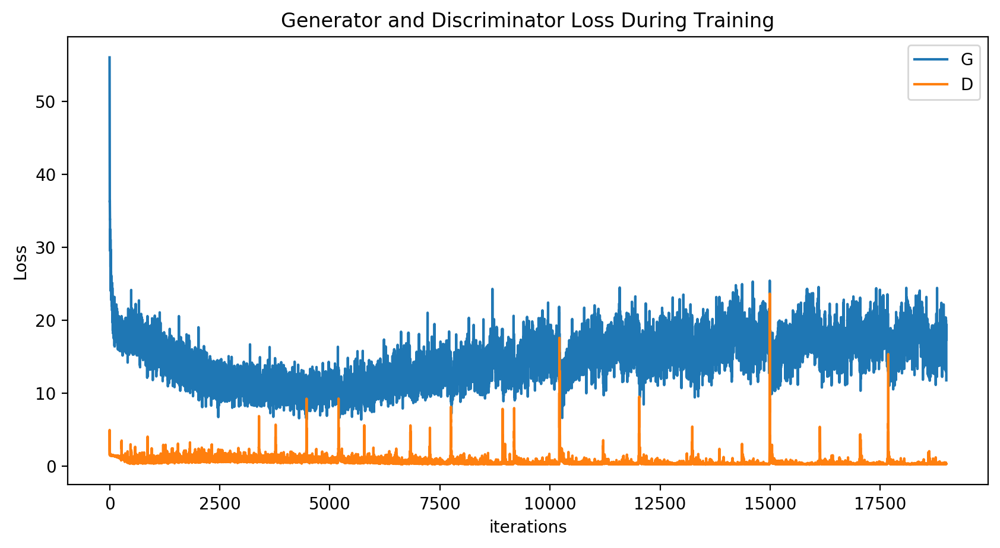

In [21]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(losses_g,label="G")
plt.plot(losses_d,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

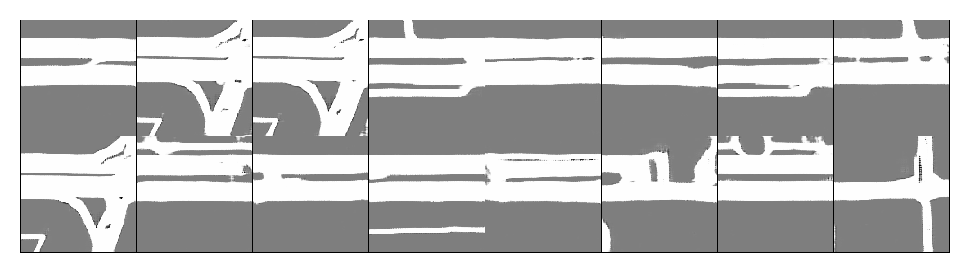

In [22]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in intermediate_images]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

### Evaluate trained generator model on test data (Qualitative)

In [23]:
labeled_testset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_test,
                                  img_transform=transforms.Compose([transforms.CenterCrop(256),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

testloader = torch.utils.data.DataLoader(labeled_testset,
                                          batch_size=1,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [24]:
losses_g_L1_eval = []
inference_images = []

generator.eval()

Generator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(18, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (resnet_block): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Dropout(p=0.5, inplace=False)
        (4): Conv2d(256, 256, kernel_size=(3, 3), strid

In [25]:
####################################
############ INFERENCE #############
####################################

for real_18ch, real_map in tqdm(testloader):
    real_18ch = real_18ch.to(device)
    real_map = real_map.to(device)

    """
    GENERATOR INFERENCE
    """
    gen_map = generator(real_18ch)
    loss_g_L1 = criterion_L1(gen_map, real_map)

    """
    COMPILE TRAINING STATISTICS
    """
    losses_g_L1_eval.append(loss_g_L1.item())
    inference_images.append(np.hstack((real_map.cpu().view([1,256,256]), (gen_map.detach().cpu().view([1,256,256])*0.5) + 0.5)))

100%|██████████| 504/504 [00:28<00:00, 17.50it/s]


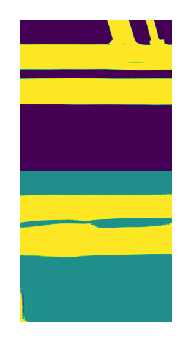

In [26]:
# %%capture
fig = plt.figure(figsize=(4,2))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)).squeeze(), animated=True)] for i in inference_images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())